# Installing/Run Guide

## Install Anaconda
Anaconda Distribution includes Jupyter - Python Notebook (3.7):
https://www.anaconda.com/distribution/#download-section

## Install packages
pip install googletrans

pip install wordcloud

pip install fa2

pip install python-louvain

pip install tweepy

## Install nltk
import nltk

nltk.download()

- Choose "book" collection and download

## Include data files
These files need to be 
- DK_pol.csv
- dataset.txt


# Initialization

In [1]:
import pandas as pd
import io
import re
import string
import operator
import time, sys
import networkx as nx
import numpy as np
import community
import nltk
import random
import tweepy
import math
import matplotlib.pyplot as plt
import community
import operator
import statistics
import numpy as np
import json
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud, STOPWORDS
from googletrans import Translator
from nltk import word_tokenize
from nltk.corpus import stopwords
from collections import Counter
from matplotlib import cm
from fa2 import ForceAtlas2
# Use forceAtlas algorithm
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=False,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.01,
                        strongGravityMode=False,
                        gravity=15.0,

                        # Log
                        verbose=True)

# Get the 200 latest tweets

* 1 - Load the dataframe
* 2 - Set tweepy API keys 
* 3 - Use tweepy method to download the latest 200 tweets
* 4 - Save each politicians tweets to txt files

In [2]:
def loadDataframe(filepath):
    return pd.read_csv(filepath)

def setkeys():
    # Tweepyy : 
    consumer_key = "PXrGuEfiw8DENiIGm4ekaG1pg"
    consumer_secret = "b28AvVHYuFUSRx70piyS2sKIpIESVbhSBmDLTC0jp8PxR3Q2BA"
    access_token = "1964800549-Ki3EvtFBc4IwZSebKKSJpxUGUwGY6xMhuagMMRw"
    access_token_secret = "CX08pPOQMD65az3uXD1gX1y9KfhLGYONbmYp0sZOKeyfy"
    auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
    auth.set_access_token(access_token, access_token_secret)
    api = tweepy.API(auth)
    
def get_timeline(userID):
    try:
        tweets = api.user_timeline(screen_name=userID, 
                           # 200 is the maximum allowed count
                           count=200,
                           include_rts = True,
                           # Necessary to keep full_text 
                           # otherwise only the first 140 words are extracted
                           tweet_mode = 'extended',
                           exclude_replies = True
                           )
    
    except:
        print(userID + "'s twitter profile was not found")
    return tweets

def tweets_to_txt():
    for i in dataframe.index:
        userID = dataframe["Twitter_ID"][i]
        name = dataframe["Name"][i]
        tweets = get_timeline(userID)
    
        try:
            file = open('./projektA/'+str(name)+".txt","w+",encoding= "utf8")
            for info in tweets:
                file.write(info.full_text)
                file.write("\n\n\n")
            file.close()
        except:
            print(name + "'s twitter profile was not found")  
            


In [3]:
G = nx.DiGraph()
H = nx.DiGraph()
dataframe = loadDataframe('DK_pol.csv')
setkeys()
#tweets_to_txt():

# Create a graph based on retweets
* 1 - add nodes to a directed graph
* 2 - sort the retweets, exclude retweets outside the parliament
* 3 - add weighted edges 

In [4]:
def addNodes(Graph):
    # Add nodes and node parameters
    for i in dataframe.index:
        Graph.add_node(dataframe['Twitter_ID'][i], 
                   Name = dataframe['Name'][i], 
                   wikiPage = dataframe['WikiPage'][i], 
                   party = dataframe['Party'][i], 
                   age = dataframe['Age'][i])
    
def get_retweets():
    # Find the retweets and put it in to a dictonary
    retweet_dict = {}
    total_retweets_parliament = 0
    rt_ = 0
    
    for i in dataframe.index:
        name = dataframe["Name"][i]
        tw_name = dataframe["Twitter_ID"][i]
        try:
            file = open('./projektA/'+str(name)+".txt","r",encoding= "utf8")   
        except:
            print(name + "does not exist in the folder")
        
        tweets = file.read()
    
        # Use regular expression to find all string starting with RT @ followed by w+
        retweets = re.findall(r"\bRT @\w+", tweets)
        retweet_dict.setdefault(tw_name,[])
        rt_ = rt_ + len(retweets)
        for rt in retweets:
            
            # Using re.sub to remove the RT @ part before the twitter name
            sub_rt = re.sub(r"\bRT @","",rt)
            if(sub_rt in list(dataframe['Twitter_ID'])):
                retweet_dict[tw_name].append(sub_rt)
                total_retweets_parliament = total_retweets_parliament + 1
                
    print("Total retweets : "+str(rt_))
    print("Total number of retweets in parliament is : " + str(total_retweets_parliament))
    return retweet_dict         

def get_mentions():
    
    mention_dict = {}
    total_mentions_parliament = 0
    mentions_ = 0
    
    for i in dataframe.index:
        name = dataframe["Name"][i]
        tw_name = dataframe["Twitter_ID"][i]
        try:
            file = open('./projektA/'+str(name)+".txt","r",encoding= "utf8")   
        except:
            print(name + "does not exist in the folder")
        
        tweets = file.read()
    
        # Find and delete the retweets 
        tweets = re.sub(r"\bRT @\w+.*"," ", tweets)
        mentions = re.findall(r"\@(\w+)",tweets)
        
        
        mention_dict.setdefault(tw_name,[])
        mentions_ = mentions_ + len(mentions)
      
       
        for mention in mentions:
            
            if(mention in list(dataframe['Twitter_ID'])):
                mention_dict[tw_name].append(mention)
                total_mentions_parliament = total_mentions_parliament + 1
                
       
    
    print("Total mentions : "+str(mentions_))
    print("Total number of mentions in parliament is : " + str(total_mentions_parliament))
    return mention_dict  
    

def addEdges(Graph,connections):
    edge_list = []
    for i in dataframe.index:
        
        tw_name = dataframe["Twitter_ID"][i]
        name = dataframe["Name"][i]
        counter_dic = Counter(connections[tw_name])
        for name in counter_dic.keys():
            edge_list.append((tw_name,name,counter_dic[name]))
        
        Graph.add_weighted_edges_from(edge_list)


In [5]:
# Retweet Graph
retweets = get_retweets()
addNodes(G)
addEdges(G,retweets)

Total retweets : 10573
Total number of retweets in parliament is : 3314


# Create a graph based on mentions
* 1 - add nodes to a directed graph
* 2 - sort the retweets, exclude retweets outside the parliament
* 3 - add weighted edges 

In [6]:
# Mention Graph
mentions = get_mentions()
addNodes(H)
addEdges(H,mentions)

Total mentions : 7269
Total number of mentions in parliament is : 1552


# Generate directed graph
* 1 - Count how many times each politician is retweeted or mentioned (This is done via counter since we wanted to count duplicates instead of in degree)
* 2 - Make a node size map based on the counted retweets/mentions
* 3 - Make a label map for to show the top 10 retweets/mentions politicians
* 4 - Make a color map to illustrate which nodes belongs to which party
* 5 - Draw the graph with the maps created in the methods above

In [159]:
def count_retweets(retweets_dict):
    times_retweet_dict = {}
    
    for i in dataframe.index:
        name = dataframe["Name"][i]
        twitter_ID = dataframe["Twitter_ID"][i]
    
        count = 0
        for items in retweets_dict.values():
            for item in items:
                if(item == twitter_ID):
                    count += 1
                    
        times_retweet_dict[name] = count
    
    return times_retweet_dict 

def count_mentions(mentions_dict):
    times_mentions_dict = {}
    
    for i in dataframe.index:
        name = dataframe["Name"][i]
        twitter_ID = dataframe["Twitter_ID"][i]
    
        count = 0
        for items in mentions_dict.values():
            for item in items:
                if(item == twitter_ID):
                    count += 1
                    
        times_mentions_dict[name] = count
    
    return times_mentions_dict 

def get_node_size_map(counted_dict):
    node_size_map = []
    
    for i in dataframe.index:
        name = dataframe["Name"][i]
        twitter_ID = dataframe["Twitter_ID"][i]
    
        count = 0
        for items in counted_dict.values():
            for item in items:
                if(item == twitter_ID):
                    count += 1
                    
        node_size_map.append(5 + count * 15)
    return node_size_map
    
def get_label_map(top_map): 
    label_map = {}
    for i in dataframe.index:
        name = dataframe["Name"][i]
        party = dataframe["Party"][i]
        tw_name = dataframe["Twitter_ID"][i]
        
        for j in range(len(top_map)):
            if name in top_map[j][0]:
                label_map[tw_name] = name +"   "+str(top_map[j][1])
                break
            else:
                label_map[tw_name] = ""
                
                
    return label_map



def get_color(party):
    color_parties = {
    "S": "#cb0001",
    "V": "#050099",
    "DF": "#fee60a",
    "RV": "#b129dc",
    "SF": "#fe007b",
    "KF": "#05500a",
    "ALT": "#00fe00",
    "NB": "#ffccff",
    "LA": "#00feff",
    "EL": "#800001"
    }
    return color_parties.get(party,"#999999")



def get_color_map():
    color_map = []
    for i in dataframe.index:
        name = dataframe["Name"][i]
        party = dataframe["Party"][i]
        tw_name = dataframe["Twitter_ID"][i]
        color_map.append(get_color(party))    
    return color_map


def drawDiGraph(Graph,label_map_,color_map_,node_size_map_):
    H = Graph.to_undirected()
    positions = forceatlas2.forceatlas2_networkx_layout(H, pos=None, iterations=1000)
    fig = plt.figure(figsize=(30,30))
    nx.draw_networkx(H,pos = positions, 
                 node_size = node_size_map_,
                 labels = label_map_,
                 node_color = color_map_,
                 width = 0.1,
                 node_labels = True,
                 font_size = 30)
    plt.show()

In [8]:
# Maps and parameters for retweet graph
retweets_count = count_retweets(retweets)
retweet_count_sorted = sorted(retweets_count.items(),key = operator.itemgetter(1),reverse=True)[:10]
node_size_map1 = get_node_size_map(retweets)
label_map1 = get_label_map(retweet_count_sorted)
color_map = get_color_map()

In [9]:
# Maps and parameters for mentions graph
mentions_count = count_mentions(mentions)
node_size_map2 = get_node_size_map(mentions)
label_map2 = get_label_map(sorted(mentions_count.items(),key = operator.itemgetter(1),reverse=True)[:10])
color_map = get_color_map()

# Draw graphs 
* 1 - Draw the retweets graph, top ten names is shown along with the number of retweets
* 2 - Draw the mentions graph, top ten names is shown along with the number of mentions

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:03<00:00, 317.98it/s]


BarnesHut Approximation  took  0.48  seconds
Repulsion forces  took  2.43  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.03  seconds
AdjustSpeedAndApplyForces step  took  0.09  seconds


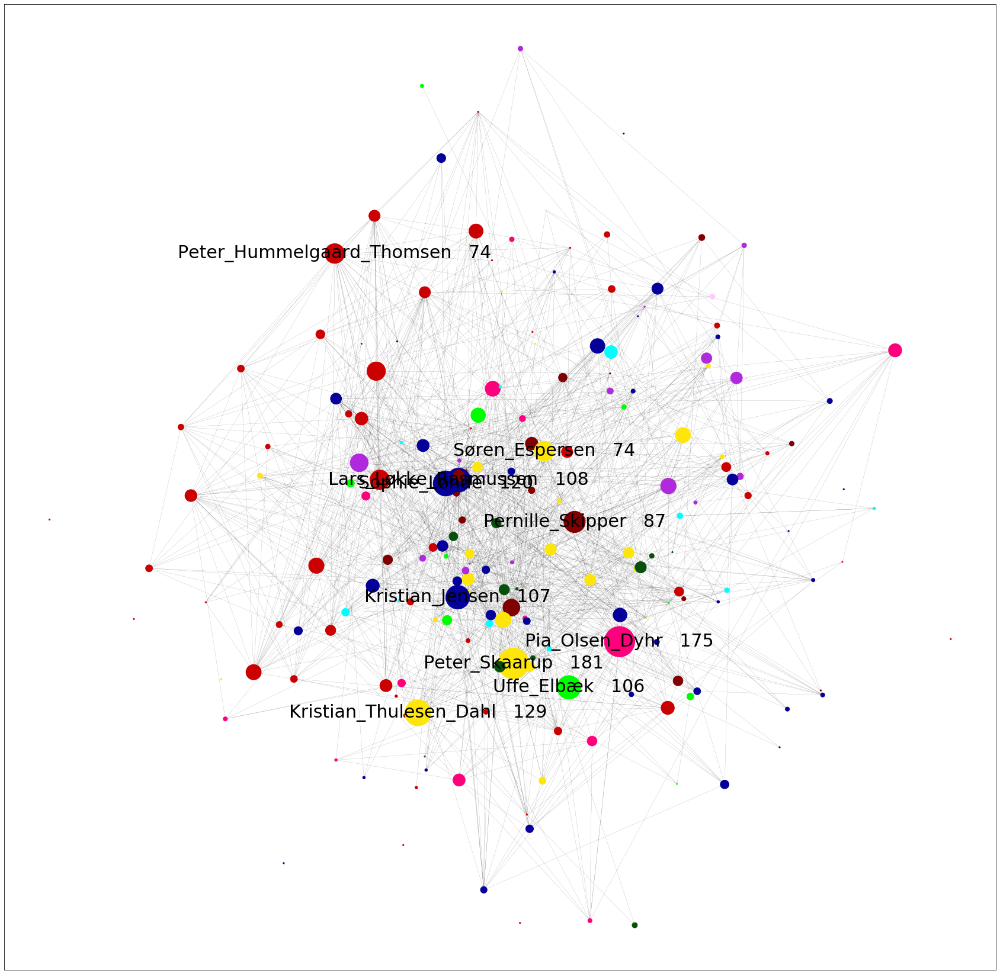

In [160]:
drawDiGraph(G,label_map1,color_map,node_size_map1)

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:01<00:00, 517.13it/s]


BarnesHut Approximation  took  0.28  seconds
Repulsion forces  took  1.51  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.04  seconds


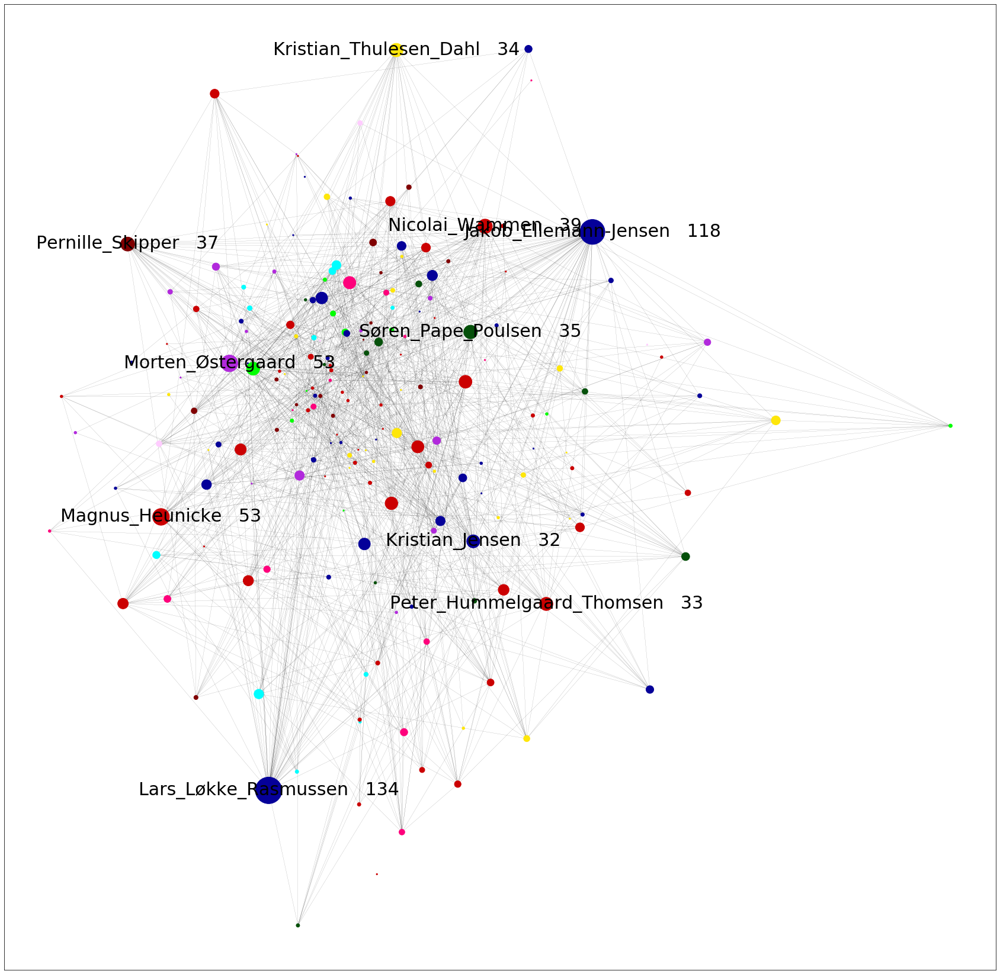

In [12]:
drawDiGraph(H,label_map2,color_map,node_size_map2)

When looking at the two graphs, they do indeed look similar. However, the first thing that can be noticed is the top ten numbers. In retweets, they go from 181 to 74. In mentions, it is a bit different, starting at 134 and dropping to 33. This indicates that retweets are more used than mentions when comparing communication between members of parliament. This is backed up by the stats printed earlier that stated: 3314 retweets among members and only 1552 mentions.
The next thing that can be noticed is some of the top ten politicians is in both graphs. Most of these politicians are or have recently been major players in parliament and their party. 

# Show common statitics 
* 1 - Average deegree for retweets and mentions 
* 2 - Top and bottom ten retweeters
* 3 - Top and bottom ten retweeted
* 4 - Top and bottom ten mentions 
* 5 - Top and bottom ten mentioned

In [13]:
def get_stats(tweet_graph,mention_graph,mentions_,retweets_):
    # degree
    
    # Average
    total = 0
    for name,degree in tweet_graph.out_degree():
        total = total + degree
    
    print("Average degree for retweets is : "+ str(total/199))
    print(" ")
    total = 0
    for name,degree in mention_graph.out_degree():
        total = total + degree
    print("Average degree for mentioned is : "+ str(total/199))
    print(" ")
    
    # Top and bottom degree for retweets
    
    # Highest
    sort = sorted(tweet_graph.out_degree, key=lambda x: x[1], reverse=True)
    sort = sort[:10]
    print("")
    print("Top 10 degrees for retweets are : ")
    for i in range(len(sort)):
        print(sort[i])
        
    print(" ")
        
    #Lowest
    sort2 = sorted(tweet_graph.out_degree, key=lambda x: x[1], reverse=False)
    sort2 = sort2[:10]
    print("")
    print("Bottom 10 degrees for retweets are : ")
    for j in range(len(sort2)):
        print(sort2[j])
    
    print(" ")
    
    # Top and bottom degree for mentions
    
    # Highest
    sort = sorted(mention_graph.out_degree, key=lambda x: x[1], reverse=True)
    sort = sort[:10]
    print("")
    print("Top 10 degrees for mentions are : ")
    for i in range(len(sort)):
        print(sort[i])
        
    print(" ")
        
    #Lowest
    sort2 = sorted(mention_graph.out_degree, key=lambda x: x[1], reverse=False)
    sort2 = sort2[:10]
    print("")
    print("Bottom 10 degrees for mentions are : ")
    for j in range(len(sort2)):
        print(sort2[j])
    
    print(" ")
    
        
    #Numbers of retweets made by the politician
    retweet_dict = {}
    for key in retweets_.keys():
        retweet_dict[key] = len(retweets_[key])
    rt = sorted(retweet_dict.items(), key=operator.itemgetter(1), reverse=True)[:10]
    print("Top 10 retweeters are : ")
    for i in range(len(rt)):
        print(rt[i])
    print("")
    rt_r = sorted(retweet_dict.items(), key=operator.itemgetter(1), reverse=False)[:10]
    print("Bottom 10 retweeters are : ")
    for i in range(len(rt)):
        print(rt_r[i])
    print(" ")
        
    # Number of times a politician is retweeted
    times_retweet_dict = {}
        
    # calculate retweets
    for i in dataframe.index:
        name = dataframe["Name"][i]
        twitter_ID = dataframe["Twitter_ID"][i]
    
        count = 0
        for items in retweets_.values():
                for item in items:
                    if(item == twitter_ID):
                        count += 1
        times_retweet_dict[name] = count
        
    
    # Use sorted to sort and take top and bottom 10 and put it in a list
    top_retweets = sorted(times_retweet_dict.items(),key = operator.itemgetter(1),reverse=True)[:10]
    bottom_retweets = sorted(times_retweet_dict.items(),key = operator.itemgetter(1),reverse=False)[:10]
        
    # Top 10 
    print("Top 10 retweeted are : ")
    for i in range(len(top_retweets)):
        print(top_retweets[i])
    print(" ")
    # Bottom 10 
    print("Bottom 10 retweeters are : ")
    for i in range(len(rt)):
        print(rt_r[i])
    print(" ")
        
    # Numbers of mention made by the politician
        
    # Top 10 
    mention_dict = {}
    for key in mentions_.keys():
        mention_dict[key] = len(mentions_[key])
            
    mention_top = sorted(mention_dict.items(), key=operator.itemgetter(1), reverse=True)[:10]
        
    print("Top 10 mentioners are : ")
    for i in range(len(mention_top)):
        print(mention_top[i])
    print(" ")
        
    # Bottom 10
    mention_bot = sorted(mention_dict.items(), key=operator.itemgetter(1), reverse=False)[:10]
    print("Bottom 10 mentioners are : ")
    for i in range(len(mention_bot)):
        print(mention_bot[i])
    print(" ")      
    # Number of times a politician is mentioned
    times_mentioned_dict = {}
        
    # calculate mentions
    for i in dataframe.index:
        name = dataframe["Name"][i]
        twitter_ID = dataframe["Twitter_ID"][i]
        count = 0
        for items in mentions_.values():
                for item in items:
                    if(item == twitter_ID):
                        count += 1
        times_mentioned_dict[name] = count
    # Use sorted to sort and take top and bottom 10 and put it in a list
    top_mention = sorted(times_mentioned_dict.items(),key = operator.itemgetter(1),reverse=True)[:10]
    bottom_mention = sorted(times_mentioned_dict.items(),key = operator.itemgetter(1),reverse=False)[:10]
        
    # Top 10 
    print("Top 10 mentioned are : ")
    for i in range(len(top_mention)):
        print(top_mention[i])
    print(" ")
    # Bottom 10 
    print("Bottom 10 mentioned are : ")
    for i in range(len(bottom_mention)):
        print(bottom_mention[i])
    print(" ")
        


In [14]:
get_stats(G,H,mentions,retweets)


Average degree for retweets is : 5.944723618090452
 
Average degree for mentioned is : 5.442211055276382
 

Top 10 degrees for retweets are : 
('EllenTraneNorby', 24)
('AnniMatthiesen', 22)
('JulieSkovsby', 20)
('mattiastesfaye', 20)
('AneHalsboe', 17)
('Jens_Joel', 16)
('JeppeBruus', 16)
('MalteLarsen', 16)
('BendixenPebe', 16)
('Pia_Kjaersgaard', 16)
 

Bottom 10 degrees for retweets are : 
('anderssamuelsen', 0)
('Bhaarder', 0)
('BirgitteBergman', 0)
('Bjarne_Laustsen', 0)
('carolinamaier', 0)
('Antorini123', 0)
('ech58', 0)
('HaChrSchmidt', 0)
('HelleThorning_S', 0)
('SociologenHD', 0)
 

Top 10 degrees for mentions are : 
('Kristensenberth', 30)
('mfMorten', 17)
('MetteGjerskov', 16)
('ammitzbollbille', 16)
('RabjergMadsen', 15)
('martinlidegaard', 15)
('RuneLundEL', 15)
('ChristinaEgelun', 14)
('EvaFlyvholm', 14)
('skaarup_df', 14)
 

Bottom 10 degrees for mentions are : 
('Bhaarder', 0)
('Bjarne_Laustsen', 0)
('ChristianJuhl2', 0)
('ChristianPoll', 0)
('ToftJakobsen', 0)
('Dorth

# Betweenness Centrality
* 1 - Calculate betweenness centrality
* 2 - Make labelmap for top 10 politicians with highest centrality
* 3 - Make node size map based their score in betweenness centrality

In [15]:
def calculate_betweenness(Graph):
    return nx.betweenness_centrality(Graph)
def betweenness_label_map(bc,Graph):
    label_degrees = {}
    bc_sort = sorted(bc.items(),key = operator.itemgetter(1),reverse=True)
    bc_sort = bc_sort[:10]
    bc_sort1 = [x[0] for x in bc_sort]
    for name in bc.keys():
        
        if(name in bc_sort1):
            label_degrees[name] = Graph.nodes[name]["Name"]
        else:
            label_degrees[name] = ""
            
    return label_degrees


def betweenness_size_map(bc,Graph):
    betweenness_degrees_map = []
    for node in Graph:
        # Map to fix node size based on centrality
        betweenness_degrees_map.append(bc[node]*10000)
    
    return betweenness_degrees_map

def betweeness_graph(Graph,size_map,label_):
    fig = plt.figure(figsize=(30,30))
    positions = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=1000)
    nx.draw(Graph.to_undirected(), positions, 
        node_size = size_map, 
        with_labels=True,
        labels = label_, 
        node_color = color_map, 
        edge_color="#727376",
        width = 0.2,
        font_size = 28)
    plt.show()

# Retweets

In [16]:
retweet_betweenness = calculate_betweenness(G)
retweet_betweenness_label_map = betweenness_label_map(retweet_betweenness,G)
retweet_betweenness_node_size_map = betweenness_size_map(retweet_betweenness,G)

# Mentions 

In [17]:
mention_betweenness = calculate_betweenness(H)
mention_betweenness_label_map = betweenness_label_map(mention_betweenness,H)
mention_betweenness_node_size_map = betweenness_size_map(mention_betweenness ,H)

# Generate graph for retweets and mentions
* 1 - use node size map
* 2 - use label map
* 3 - use color map generated earlier 

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 488.36it/s]


BarnesHut Approximation  took  0.31  seconds
Repulsion forces  took  1.59  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.04  seconds


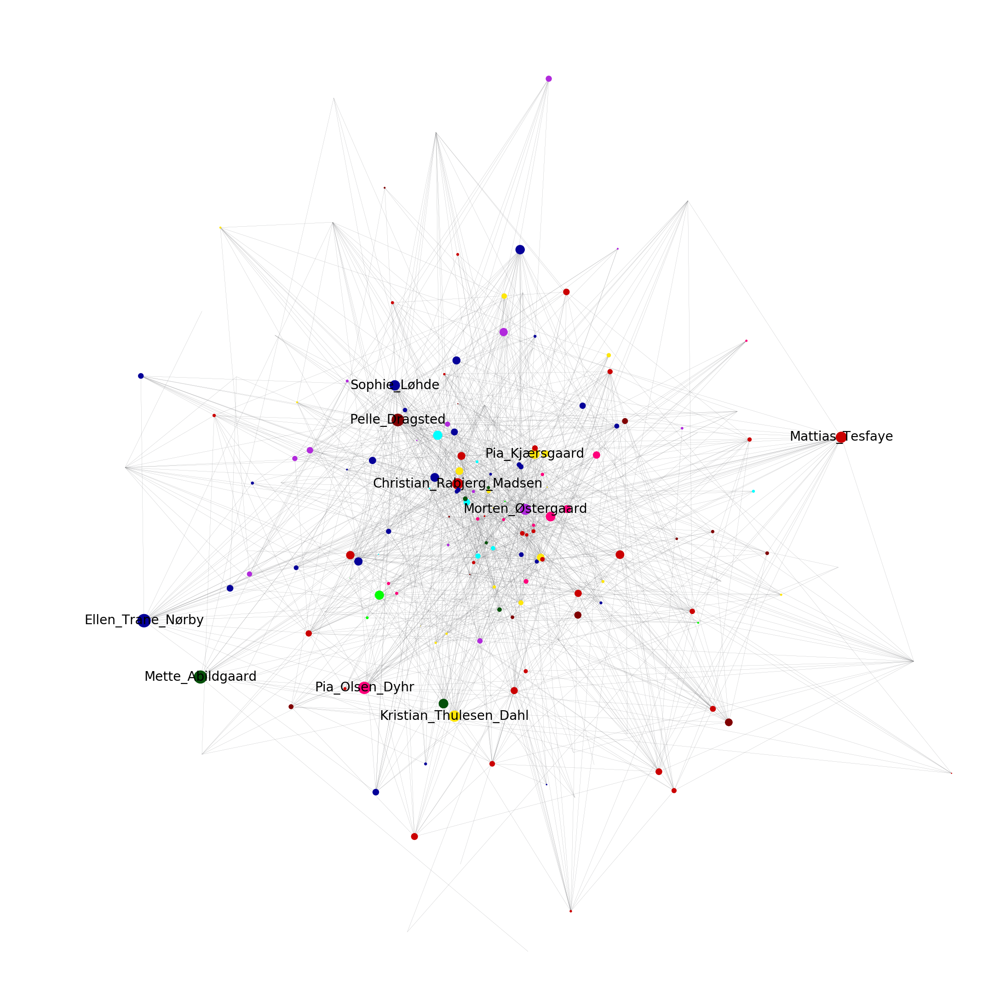

In [18]:
betweeness_graph(G,retweet_betweenness_node_size_map,retweet_betweenness_label_map)

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 470.52it/s]


BarnesHut Approximation  took  0.33  seconds
Repulsion forces  took  1.63  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.08  seconds


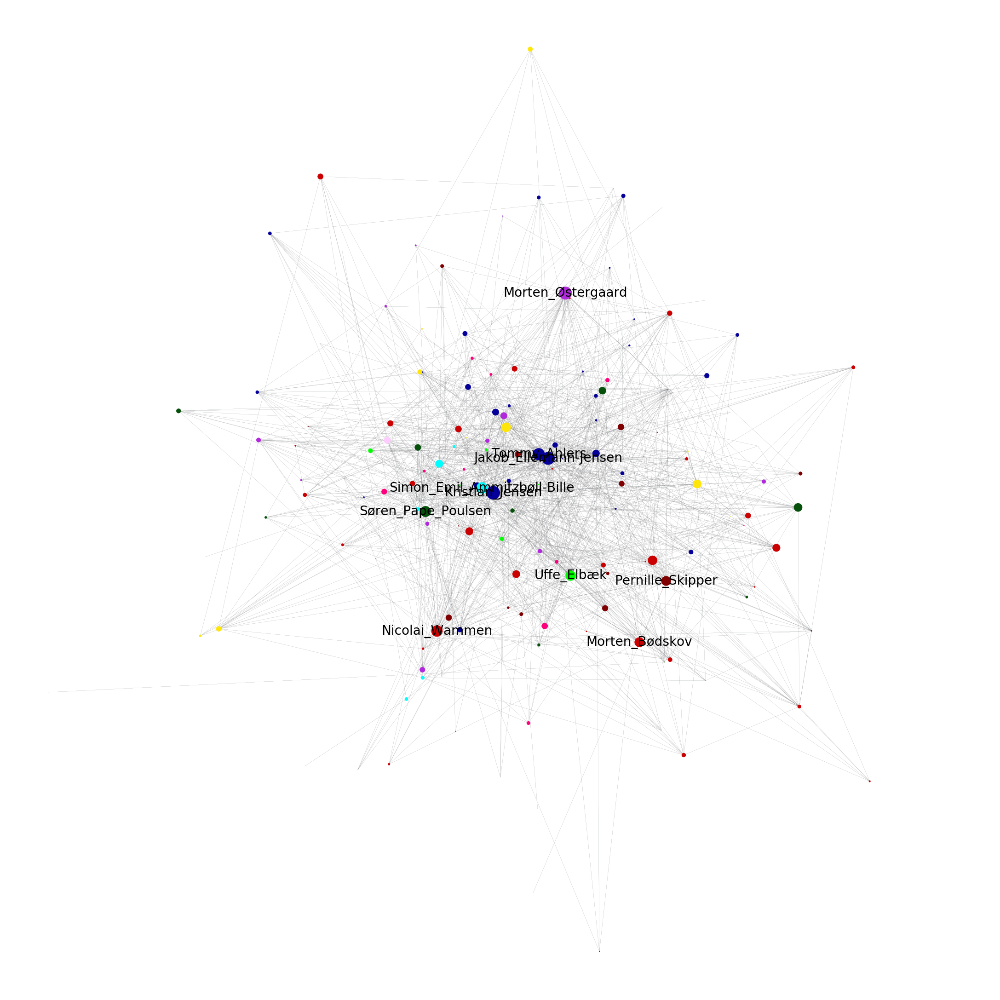

In [19]:
betweeness_graph(H,mention_betweenness_node_size_map,mention_betweenness_label_map)

In [20]:
def top_betweenness(mentions_,retweets_):
    
    bc_sort = sorted(calculate_betweenness(retweets_).items(),key = operator.itemgetter(1),reverse=True)
    print("Retweets : ")
    print ("Top ten parlement members with highest Betweensess Centrality is:")
    for i in range(10):
        print("-> " + str(round(bc_sort[i][1],5))+"   " + str(bc_sort[i][0]) + "     " +str(G.nodes[bc_sort[i][0]]["party"]))
    print("")
    
    bc_sort = sorted(calculate_betweenness(mentions_).items(),key = operator.itemgetter(1),reverse=True)
    print("Mentions : ")
    print ("Top ten parlement members with highest Betweensess Centrality is:")
    for i in range(10):
        print("-> " + str(round(bc_sort[i][1],5))+"   " + str(bc_sort[i][0]) + "     " +str(G.nodes[bc_sort[i][0]]["party"]))
    print("")

In [21]:
top_betweenness(H,G)

Retweets : 
Top ten parlement members with highest Betweensess Centrality is:
-> 0.07988   EllenTraneNorby     V
-> 0.07639   metteabildgaard     KF
-> 0.0692   pelledragsted     EL
-> 0.06671   PiaOlsen     SF
-> 0.05563   Kristianthdahl     DF
-> 0.05372   RabjergMadsen     S
-> 0.05358   mattiastesfaye     S
-> 0.05254   oestergaard     RV
-> 0.04625   sophieloehde     V
-> 0.04342   Pia_Kjaersgaard     DF

Mentions : 
Top ten parlement members with highest Betweensess Centrality is:
-> 0.0819   Kristian_Jensen     V
-> 0.07408   JakobEllemann     V
-> 0.07405   oestergaard     RV
-> 0.06416   aahlers     V
-> 0.05633   NWammen     S
-> 0.05601   ammitzbollbille     LA
-> 0.05129   SorenPape     KF
-> 0.04586   uffeelbaek     ALT
-> 0.04169   mfMorten     S
-> 0.04095   PSkipperEL     EL



# Eigenvector Centrality
* 1 - Calculate eigenvector centrality
* 2 - Make labelmap for top 10 politicians with highest centrality
* 3 - Make node size map based their score in eigenvector centrality

In [22]:
def eigenvector_label_map(Graph):
    label_degrees = {}
    ec = nx.eigenvector_centrality(Graph)
    ec_sort = sorted(ec.items(),key = operator.itemgetter(1),reverse=True)
    ec_sort = ec_sort[:10]
    ec_sort1 = [x[0] for x in ec_sort]
    
    for name in ec.keys():
        
        if(name in ec_sort1):
            label_degrees[name] = Graph.nodes[name]["Name"]
        else:
            label_degrees[name] = ""
    return label_degrees


def eigenvector_size_map(Graph):
    eigenvector_degrees_map = []
    ec = nx.eigenvector_centrality(Graph)
    for node in Graph:
        # Map to fix node size based on centrality
        eigenvector_degrees_map.append(ec[node]*10000)
    
    return eigenvector_degrees_map

def draw_eigenvector(Graph,node_size_map,eigen_label_map):
    fig = plt.figure(figsize=(20,20))
    positions = forceatlas2.forceatlas2_networkx_layout(Graph, pos=None, iterations=1000)
    nx.draw(G.to_undirected(), positions, 
        node_size = node_size_map, 
        with_labels=True,
        labels = eigen_label_map, 
        node_color = color_map, 
        edge_color="#727376",
        width = 0.2,
        font_size = 20)
    plt.axis('off')
    plt.show()

# Retweets

In [23]:
retweet_eigenvector_label_map = eigenvector_label_map(G)
retweet_eigenvector_node_size_map = eigenvector_size_map(G)

# Mentions

In [24]:
mention_eigenvector_label_map = eigenvector_label_map(H)
mention_eigenvector_node_size_map = eigenvector_size_map(H)

# Generate graph for retweets and mentions
* 1 - use node size map
* 2 - use label map
* 3 - use color map generated earlier 

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 473.34it/s]


BarnesHut Approximation  took  0.39  seconds
Repulsion forces  took  1.60  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.05  seconds


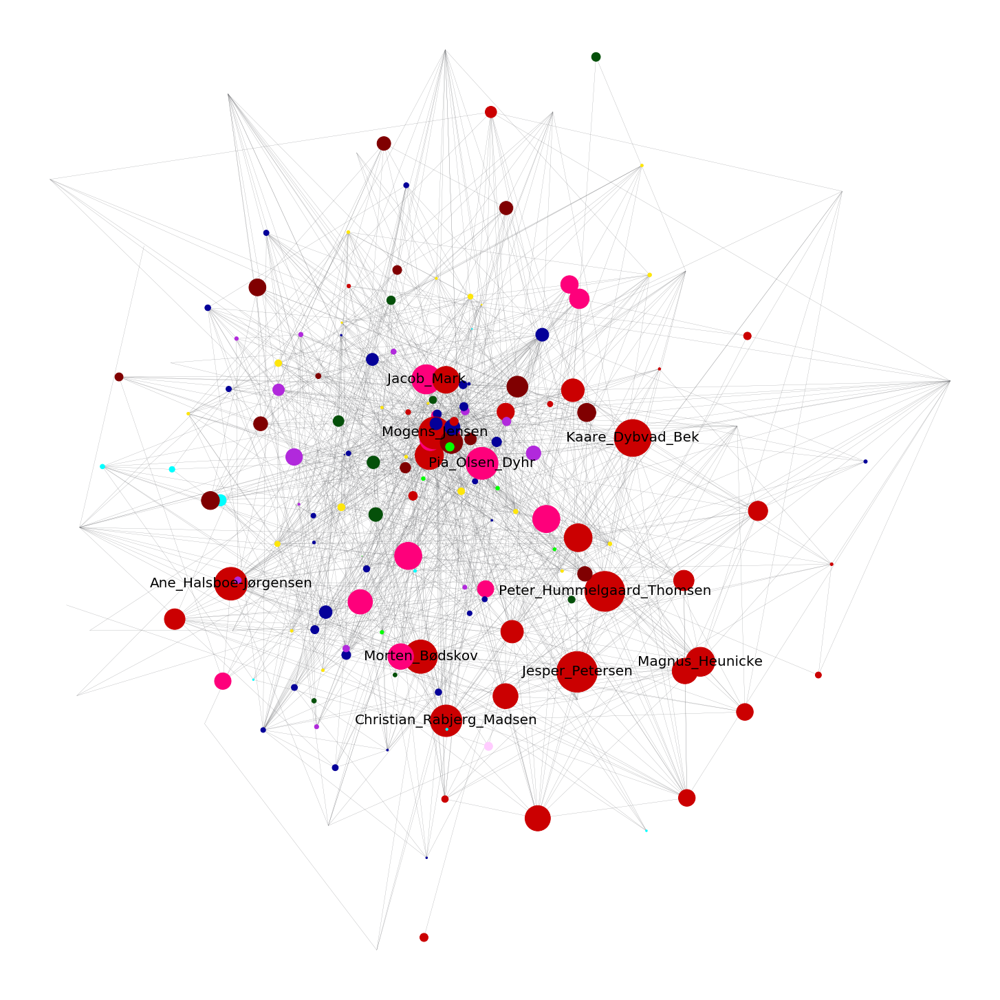

In [25]:
draw_eigenvector(G,retweet_eigenvector_node_size_map,retweet_eigenvector_label_map)

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 493.19it/s]


BarnesHut Approximation  took  0.34  seconds
Repulsion forces  took  1.57  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.05  seconds


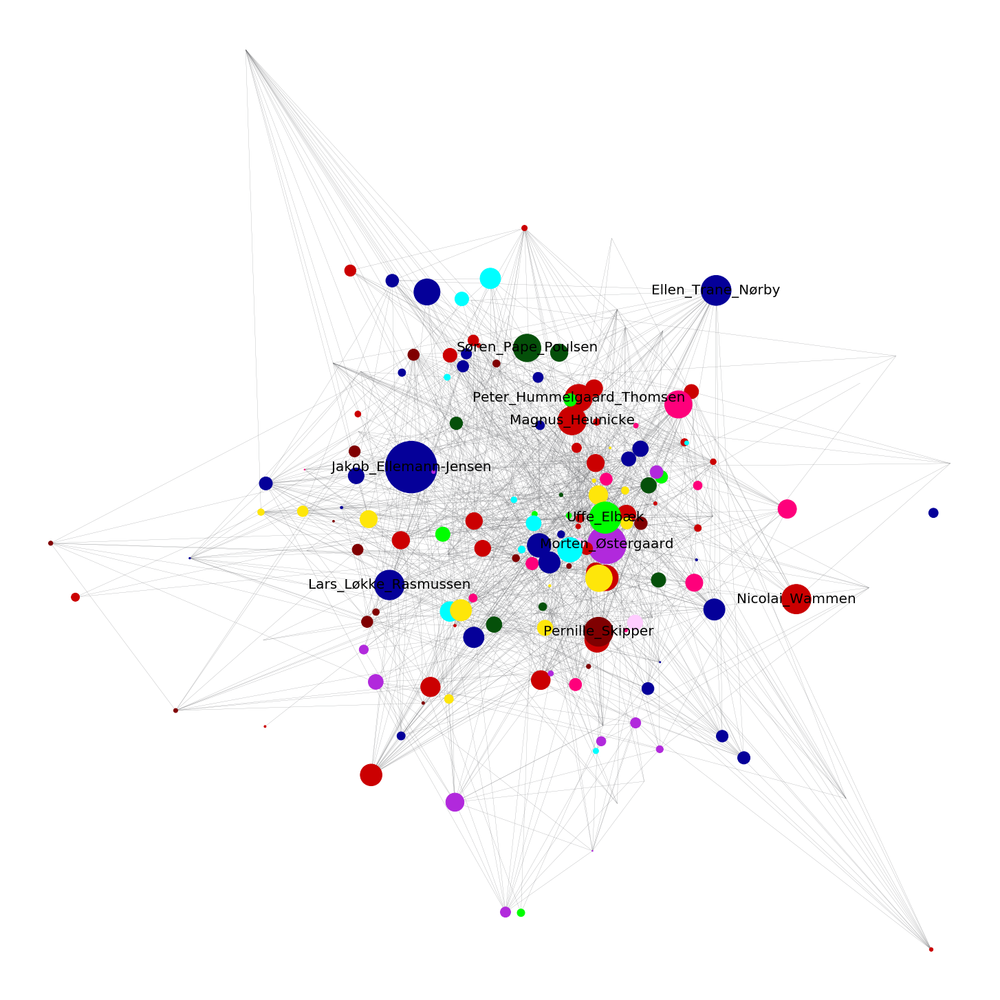

In [26]:
draw_eigenvector(G,mention_eigenvector_node_size_map,mention_eigenvector_label_map)

In [27]:
def top_eigencentrality(mentions_,retweets_):
    ec = nx.eigenvector_centrality(retweets_)
    bc_sort = sorted(ec.items(),key = operator.itemgetter(1),reverse=True)
    print("Retweets : ")
    print ("Top ten parlement members with highest eigencentrality is:")
    for i in range(10):
        print("-> " + str(round(bc_sort[i][1],5))+"   " + str(bc_sort[i][0]) + "     " +str(G.nodes[bc_sort[i][0]]["party"]))
    print("")
    
    ec = nx.eigenvector_centrality(mentions_)
    bc_sort = sorted(ec.items(),key = operator.itemgetter(1),reverse=True)
    print("Mentions : ")
    print ("Top ten parlement members with highest eigencentrality is:")
    for i in range(10):
        print("-> " + str(round(bc_sort[i][1],5))+"   " + str(bc_sort[i][0]) + "     " +str(G.nodes[bc_sort[i][0]]["party"]))
    print("")

In [28]:
top_eigencentrality(H,G)

Retweets : 
Top ten parlement members with highest eigencentrality is:
-> 0.34912   Jesper_Pet     S
-> 0.3379   PHummelgaard     S
-> 0.28879   KaareDybvad     S
-> 0.23635   mfMorten     S
-> 0.22729   AneHalsboe     S
-> 0.2181   PiaOlsen     SF
-> 0.21743   MogensJensenS     S
-> 0.21166   RabjergMadsen     S
-> 0.18113   jacobmark_sf     SF
-> 0.17858   Heunicke     S

Mentions : 
Top ten parlement members with highest eigencentrality is:
-> 0.56506   JakobEllemann     V
-> 0.31331   oestergaard     RV
-> 0.20887   uffeelbaek     ALT
-> 0.1904   EllenTraneNorby     V
-> 0.18616   larsloekke     V
-> 0.18312   NWammen     S
-> 0.17881   PSkipperEL     EL
-> 0.16867   Heunicke     S
-> 0.16129   SorenPape     KF
-> 0.15832   PHummelgaard     S



# Community detection
* 1 - Get partion 
* 2 - get modularity
* 3 - calculate communitys
* 4 - assign each community a random color
* 5 - generate color map

In [29]:
def randomColor(): 
    color = [random.randint(0, 255),random.randint(0, 255),random.randint(0, 255)]
    return color

def convert_to_hex(rgb_color) :
    return '#%02x%02x%02x' % (rgb_color[0], rgb_color[1], rgb_color[2])


def get_partition(Graph):
    return community.best_partition(Graph.to_undirected())

def get_modularity(Graph,partition):
    return community.modularity(partition,Graph.to_undirected())

def calculate_community(Graph,partition): 
    for communitys in set(partition.values()):
        
        list_of_nodes = [nodes for nodes in partition.keys() if partition[nodes] == communitys]
        color = randomColor()
        
        for node in list_of_nodes:
            
            Graph.nodes[node]['color'] = convert_to_hex(color)
            
    return list_of_nodes

def get_color_map(Graph):
    color_map = []
    for nodes in Graph:
        color_map.append(Graph.nodes[nodes]['color'])
    return color_map

    


# Retweets

In [30]:
retweet_partition = get_partition(G)
retweet_modularity = get_modularity(G,retweet_partition)
retweet_community_nodes = calculate_community(G,retweet_partition)
retweet_color_map = get_color_map(G)

# Mention

In [31]:
mention_partition = get_partition(H)
mention_modularity = get_modularity(H,mention_partition)
mention_community_nodes = calculate_community(H,mention_partition)
mention_color_map = get_color_map(H)

# Generate graph for retweets and mentions
* 1 - use color map generated 

In [32]:
def draw_community(Graph,color_map):
    positions = forceatlas2.forceatlas2_networkx_layout(Graph.to_undirected(), pos=None, iterations=1000)
    options = {    
    'node_color': color_map,
    'node_shape': '^',
    'with_labels': False,
    'node_size': 100,
    'width': 0.1,
    'pos': positions,
    }
    fig= plt.figure(figsize=(15,12))
    nx.draw(Graph.to_undirected(), **options)
    plt.show()

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 475.61it/s]


BarnesHut Approximation  took  0.29  seconds
Repulsion forces  took  1.68  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.05  seconds


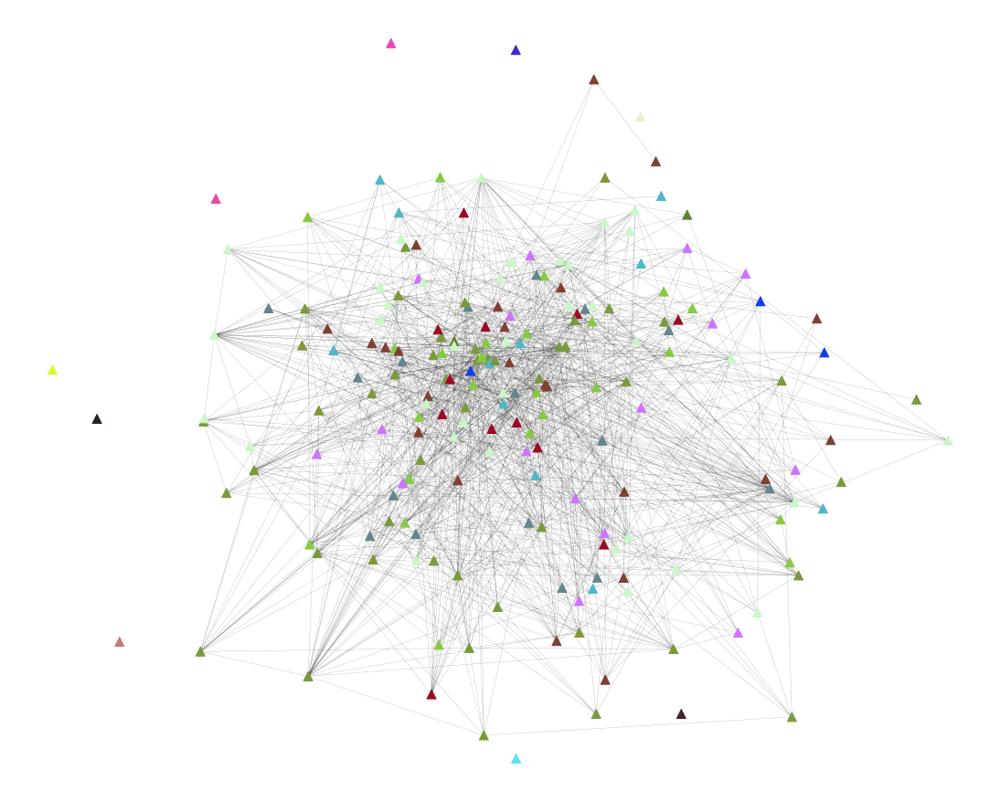

In [33]:
draw_community(G,retweet_color_map)

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 496.69it/s]


BarnesHut Approximation  took  0.30  seconds
Repulsion forces  took  1.57  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.06  seconds


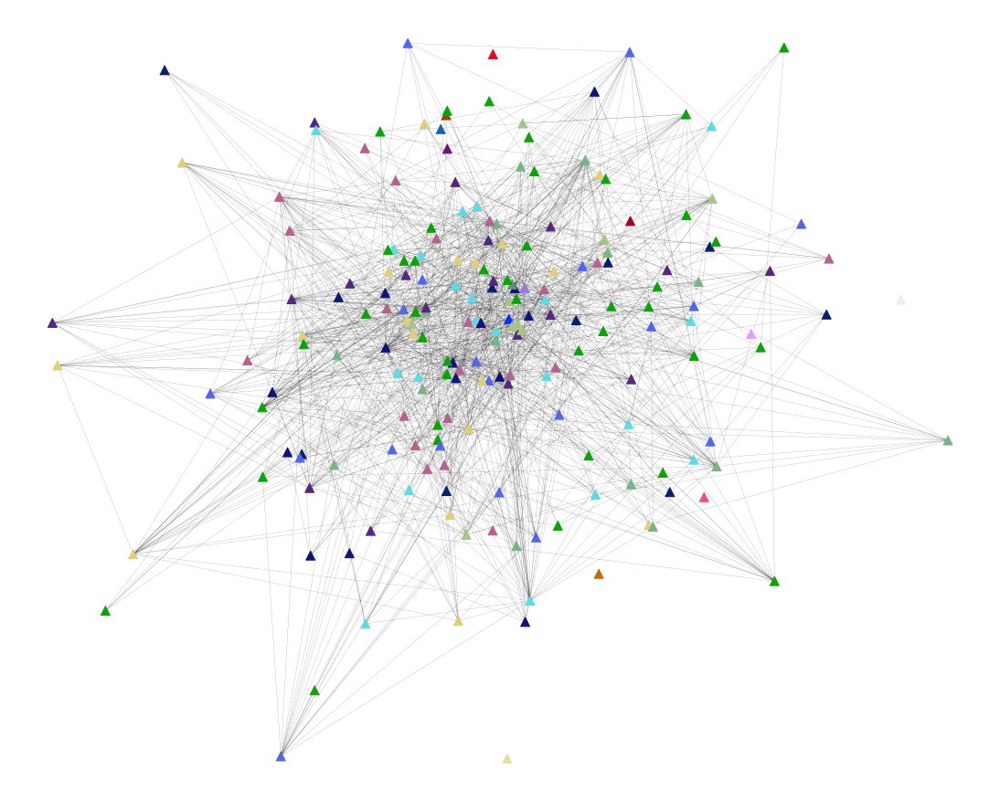

In [34]:
draw_community(H,mention_color_map)

Looking at the two graphs, it is difficult to conclude much about the communities. Therefore a more in-depth analysis will be done later in sorting the community and looking at why the people belonging to the community they do.

# Analyse Community 
* 1 - Retweets
* 2 - Mentions 

In [35]:
def sort_comunity(Graph):
    comunity_dict_party = {}
    comunity_dict_name = {}
    
    sorted_comunity_dict = {}
    partition = community.best_partition(Graph.to_undirected())
    for i in range(len(partition)):
        comunity_dict_party[i] = []
        comunity_dict_name[i] = []
    for key in partition.keys():
        comunity_dict_party[partition[key]].append(G.nodes[key]["party"])
        comunity_dict_name[partition[key]].append(key)

    
    for j in range(len(comunity_dict_party)):
        if(len(comunity_dict_party[j]) < 2):
            comunity_dict_party.pop(j)
            comunity_dict_name.pop(j)
    
   
    for k in range(len(comunity_dict_party)):
        try:
            sorted_comunity_dict[k] = Counter(comunity_dict_party[k])
        except KeyError:
            pass
    
    return sorted_comunity_dict,comunity_dict_name

In [153]:
sort,name = sort_comunity(G)
sort

{0: Counter({'LA': 9, 'KF': 10, 'NB': 4}),
 1: Counter({'S': 45, 'KF': 1}),
 2: Counter({'RV': 16}),
 3: Counter({'SF': 12}),
 4: Counter({'V': 35, 'EL': 1, 'SF': 1}),
 7: Counter({'ALT': 10, 'S': 1}),
 8: Counter({'LA': 2, 'V': 1}),
 9: Counter({'DF': 24})}

# Analysing Retweet Communitys
Looking at the different communitys most of them are as expected. In community number one, one member of "konservative folkeparti" is found. 
In community number four two politicians stand out, one from "enhedslisten" and one from "socialistisk folkeparti". In number seven a "socialdemokrat" has found its way into "alternativets" community. Lastly two "liberal alliance" and one "venstre" is isolated in a community. 
These communitys will be analysed below

In [37]:
def find_strangers(names,incl):
    for name in names:
        if(G.nodes[name]["party"] in incl):
            print(str(G.nodes[name]["party"]) + "     " +G.nodes[name]["Name"] + "   "   + name)

    
def find_retweeters(name):
    for key in retweets.keys():
        if(name in retweets[key]):
            print(str(G.nodes[key]["party"])+"   "+G.nodes[key]["Name"] + " has retweeted " +name +"   "+ str(G.nodes[name]["party"]))
            
def sort_rts(name,rts):
    for rt in rts:
        print( str(G.nodes[name]["party"])+ " "+name + " has retweeted " + rt + "   " + str(G.nodes[rt]["party"]))

* 1 - Find the names of the mentioned politicians
* 2 - Try to figure out why they are in that positions by looking at retweets and retweeters

In [154]:
find_strangers(name[1],"KF")
find_strangers(name[4],["EL","SF"])
find_strangers(name[7],"S")
find_strangers(name[8],["LA","V"])

KF     Brian_Mikkelsen   BrianAMikkelsen
EL     Christian_Juhl   ChristianJuhl2
SF     Jonas_Dahl   jonasdahl
S     Pernille_Schnoor   P_Schnoor
LA     Christina_Egelund   ChristinaEgelun
LA     Simon_Emil_Ammitzbøll-Bille   ammitzbollbille
V     Søren_Pind   sorenpind


The names above are the politicians that are a bit out of place. Below we will look into why they are within the "wrong" community. 

In [39]:
find_retweeters("BrianAMikkelsen")
sort_rts("BrianAMikkelsen", retweets["BrianAMikkelsen"])

KF   Brian_Mikkelsen has retweeted BrianAMikkelsen   KF
S   Mattias_Tesfaye has retweeted BrianAMikkelsen   KF
S   Simon_Kollerup has retweeted BrianAMikkelsen   KF
KF BrianAMikkelsen has retweeted BrianAMikkelsen   KF


Brian Mikkelsen is a former member of "det konservative folkeparti". He is currently CEO of the Danish Chamber of Commerce and is therefore not very active in parliament politics anymore. He has been retweeted three times, one by himself and two times by members of "socialdemokratiet". Consequently, it makes perfect sense that he is placed in the community with "socialdemokratiet"

In [40]:
find_retweeters("ChristianJuhl2")
sort_rts("ChristianJuhl2",retweets["ChristianJuhl2"])

EL ChristianJuhl2 has retweeted JanEJoergensen   V


Christian Juhl is from "enhedslisten" and is therefore far from "venstre" on the political scale. However, looking at his twitter activity, he has only been retweeted once by a member of "venstre" and has retweet nobody himself. Therefore the algorithm places him with "venstre".

In [41]:
find_retweeters("jonasdahl")
sort_rts("jonasdahl",retweets["jonasdahl"])

DF   Claus_Kvist_Hansen has retweeted jonasdahl   SF
S   Malte_Larsen has retweeted jonasdahl   SF
V   Michael_Aastrup_Jensen has retweeted jonasdahl   SF


Looking at Jonas Dahl he has been retweeted by two from blue block and one from red. 
Therefore it makes sense that he is placed in blue block

In [42]:
find_retweeters("P_Schnoor")
sort_rts("P_Schnoor",retweets["P_Schnoor"])

ALT   Ulla_Sandbæk has retweeted P_Schnoor   S
S P_Schnoor has retweeted uffeelbaek   ALT
S P_Schnoor has retweeted pelledragsted   EL
S P_Schnoor has retweeted MaiVilladsen   EL
S P_Schnoor has retweeted AneHalsboe   S
S P_Schnoor has retweeted TorstenGejl   ALT
S P_Schnoor has retweeted Heunicke   S


When looking at the same parameters for Pernille Schnoor, it is observed that she has retweeted "alternativet" twice and been retweeted by them once. Therefore she ends in "alternativets" community. 

# Community Conclusion

Common for all the deviates in the community detection is that they are not very active in twitter when measured on retweets and retweeters. This gives the algorithm less material to work with, and therefore these "errors" in placement occurs by only placing seven people somewhat wrongly. The rest are either within their party or at least in the right block. It also puts all members of "Radikale Venstre" in their community. This party is at the dead center on the political scale, and the algorithm, therefore, does an excellent job. 

# Analysing Mention Communitys
When looking at the different communities below, they are a lot different from retweets. It seems almost full random. However, this corresponds to the theory that mentions is used to discussing topics rather than just making people aware. Therefore the same analysis done one retweet will not be done here. This is because it is believed that a more in-depth analysis would be needed to make heads and tails of this data.

In [43]:
sort,name = sort_comunity(H)
sort

{0: Counter({'LA': 7,
          'KF': 1,
          'DF': 14,
          'RV': 3,
          'SF': 1,
          'NB': 2,
          'V': 1,
          'EL': 1,
          'S': 2}),
 1: Counter({'S': 4, 'KF': 3, 'V': 6, 'DF': 1, 'EL': 1, 'ALT': 1}),
 2: Counter({'RV': 3, 'S': 3, 'SF': 8, 'V': 1, 'DF': 2}),
 3: Counter({'S': 5, 'RV': 7, 'V': 3, 'EL': 1, 'DF': 1}),
 4: Counter({'S': 10, 'V': 2, 'RV': 1, 'KF': 3, 'EL': 3, 'ALT': 3}),
 5: Counter({'SF': 2, 'S': 9, 'KF': 1, 'EL': 4, 'V': 4}),
 7: Counter({'S': 4,
          'ALT': 6,
          'LA': 3,
          'V': 5,
          'SF': 1,
          'DF': 3,
          'KF': 1,
          'EL': 1}),
 8: Counter({'V': 9, 'S': 2, 'KF': 1, 'DF': 1, 'RV': 1})}

# TF IDF 
* 1 - Import the tweets from the parliament members 
* 2 - Sort through the text and remove punctuation, stop words etc and save the tweets to the party
* 3 - Calculate TF
* 4 - Calculate IDF
* 5 - Calculate TF-IDF

In [44]:
def getWords():
    
    EL = []
    SF = []
    S =  []
    RV = []
    ALT =[]
    NB = []
    LA = []
    KF = []
    V =  []
    DF = []
    
    stop_words = set(stopwords.words('danish'))
    
    for i in dataframe.index:
        filter_ = []
        userID = dataframe["Twitter_ID"][i]
        party = dataframe["Party"][i]
        name = dataframe["Name"][i]
        try:
            file = open('./projektA/'+str(name)+".txt","r",encoding= "utf8")
        except:
            print(name + "'s file was not found")  
        
        data = file.read()
        data = data.lower()
        
        
        
        data = re.sub(r"\bhttps.+", " ", data)
        data = re.sub(r"\d+", " ", data)
        data = re.sub(r"\d+", " ", data)
        data = re.sub(r"co", " ", data)
        data = re.sub(r"\\n", " ", data)
        data = re.sub(r"\b[a-zA-Z]\b", " ", data)
        data = re.sub(r"…", " ", data)
        data = re.sub(r"\brt @\w+"," ", data)
        data = re.sub("rt ", " ",data)
        data = re.sub('@[\S_]+', '', data)
        
        
        for w in string.punctuation:    
            data = data.replace(w," ")
        
        
        word_tokens = word_tokenize(data)
       
        
        for word in word_tokens:
            if(word not in stop_words):
                filter_.append(word)
        

        if(party == "EL"):
            EL.extend(filter_)
        elif(party == "S"):
            S.extend(filter_)
        elif(party == "SF"):
            SF.extend(filter_)
        elif(party == "RV"):
            RV.extend(filter_)
        elif(party == "ALT"):
            ALT.extend(filter_)
        elif(party == "NB"):
            NB.extend(filter_)
        elif(party == "LA"):
            LA.extend(filter_)
        elif(party == "KF"):
            KF.extend(filter_)
        elif(party == "V"):
            V.extend(filter_)
        elif(party == "DF"):
            DF.extend(filter_)
        else:
            print("error, "+name +" tweets has not been asigned to a party")
        
        
    return EL,SF,S,RV,ALT,NB,LA,KF,V,DF

In [45]:
EL,SF,S,RV,ALT,NB,LA,KF,V,DF = getWords()

In [46]:
def TF(words):
    tf = {}
    for k,v in words.items():
        tf[k] = float(v)/float(len(words))
    return Counter(tf)

In [47]:
EL_count = Counter(EL)
SF_count = Counter(SF)
S_count = Counter(S)
RV_count = Counter(RV)
ALT_count = Counter(ALT)
NB_count = Counter(NB)
LA_count = Counter(LA)
KF_count = Counter(KF)
V_count = Counter(V)
DF_count = Counter(DF)

TF_EL = TF(EL_count)
TF_SF = TF(SF_count)
TF_S = TF(S_count)
TF_RV = TF(RV_count)
TF_ALT = TF(ALT_count)
TF_NB = TF(NB_count)
TF_LA = TF(LA_count)
TF_KF = TF(KF_count)
TF_V = TF(V_count )
TF_DF = TF(DF_count)

In [48]:
EL = sorted(TF_EL.items(),key = operator.itemgetter(1),reverse=True)[:10]
SF = sorted(TF_SF.items(),key = operator.itemgetter(1),reverse=True)[:10]
S = sorted(TF_S.items(),key = operator.itemgetter(1),reverse=True)[:10]
RV = sorted(TF_RV.items(),key = operator.itemgetter(1),reverse=True)[:10]
ALT = sorted(TF_ALT.items(),key = operator.itemgetter(1),reverse=True)[:10]
NB = sorted(TF_NB.items(),key = operator.itemgetter(1),reverse=True)[:10]
LA = sorted(TF_LA.items(),key = operator.itemgetter(1),reverse=True)[:10]
KF = sorted(TF_KF.items(),key = operator.itemgetter(1),reverse=True)[:10]
V = sorted(TF_V.items(),key = operator.itemgetter(1),reverse=True)[:10]
DF = sorted(TF_DF.items(),key = operator.itemgetter(1),reverse=True)[:10]

print("Top ten words used by EL is : ")
for word in EL:
    print(str(word))
print("\n\n")

print("Top ten words used by SF is : ")
for word in SF:
    print(str(word))
print("\n\n")

print("Top ten words used by S is : ")
for word in S:
    print(str(word))
print("\n\n")

print("Top ten words used by RV is : ")
for word in RV:
    print(str(word))
print("\n\n")

print("Top ten words used by ALT is : ")
for word in ALT:
    print(str(word))
print("\n\n")

print("Top ten words used by NB is : ")
for word in NB:
    print(str(word))
print("\n\n")

print("Top ten words used by LA is : ")
for word in LA:
    print(str(word))
print("\n\n")

print("Top ten words used by KF is : ")
for word in KF:
    print(str(word))
print("\n\n")

print("Top ten words used by V is : ")
for word in V:
    print(str(word))
print("\n\n")

print("Top ten words used by DF is : ")
for word in DF:
    print(str(word))
print("\n\n")

Top ten words used by EL is : 
('dkpol', 0.11146172638436481)
('så', 0.03481270358306189)
('kan', 0.028908794788273615)
('mere', 0.01710097719869707)
('dkgreen', 0.016286644951140065)
('eu', 0.014250814332247556)
('the', 0.013436482084690555)
('flere', 0.013029315960912053)
('godt', 0.012927524429967427)
('dag', 0.012316775244299675)



Top ten words used by SF is : 
('dkpol', 0.07881697119851347)
('så', 0.035305048002477545)
('sf', 0.030195106844224218)
('kan', 0.02647878600185816)
('godt', 0.019665531124187056)
('tak', 0.01811706410653453)
('børn', 0.016258903685351503)
('danmark', 0.01563951687829049)
('flere', 0.01548467017652524)
('dkgreen', 0.015020130071229482)



Top ten words used by S is : 
('dkpol', 0.1193028722123488)
('så', 0.03737889124577194)
('dag', 0.029582067304936076)
('kan', 0.02872212348793212)
('the', 0.028550134724531332)
('to', 0.026486269563721836)
('tak', 0.02637161038812131)
('godt', 0.023849108524909707)
('danmark', 0.020122685317892564)
('vores', 0.02006535

# Top ten words
When looking at the top ten words, many similarities are found. Since it is mainly common words at the top, it does not show much about the parties. Therefore TF-IDF will be calculated to see if more party-specific word clouds can be generated from that.

In [49]:
def IDF(list_of_words):
    dict1 = {}
    number_list = len(list_of_words)
    for i in range(len(list_of_words)):
        for k,v in list_of_words[i].items():
            df = 0
            for j in range(number_list):
                if k in list_of_words[j]:
                    df += 1
            dict1[k] = v*math.log10(number_list/df)
    return Counter(dict1)


IDF1 = IDF([EL_count,SF_count,S_count,RV_count,ALT_count,NB_count,LA_count,KF_count,V_count,DF_count])

In [50]:
def computeTFIDF(TF_score, IDF_score):
    TF_IDF = {}
    for word, val in TF_score.items():
        try:
            
            TF_IDF[word] =  val * IDF_score[word]
                
        except:
            print(word + "does not exist in datafile")
        
    return TF_IDF

In [51]:
TFIDF_EL = computeTFIDF(TF_EL, IDF1)
TFIDF_SF = computeTFIDF(TF_SF, IDF1)
TFIDF_S = computeTFIDF(TF_S, IDF1)
TFIDF_RV = computeTFIDF(TF_RV, IDF1)
TFIDF_ALT = computeTFIDF(TF_ALT, IDF1)
TFIDF_NB = computeTFIDF(TF_NB, IDF1)
TFIDF_LA = computeTFIDF(TF_LA, IDF1)
TFIDF_KF = computeTFIDF(TF_KF, IDF1)
TFIDF_V = computeTFIDF(TF_V, IDF1)
TFIDF_DF = computeTFIDF(TF_DF, IDF1)

# Wordclouds 
* 1 - use the TFIDF for each party to generate wordclouds for every party

In [138]:
def generate_wordcloud(TFIDF): 
    fig = plt.figure(figsize=(15,15))
    wordcloud = WordCloud(
                      stopwords=STOPWORDS,
                      background_color='black',
                      width=1500,
                      height=1500
                     ).generate_from_frequencies(frequencies=TFIDF)

    plt.imshow(wordcloud)
    plt.axis('off')
    plt.show()

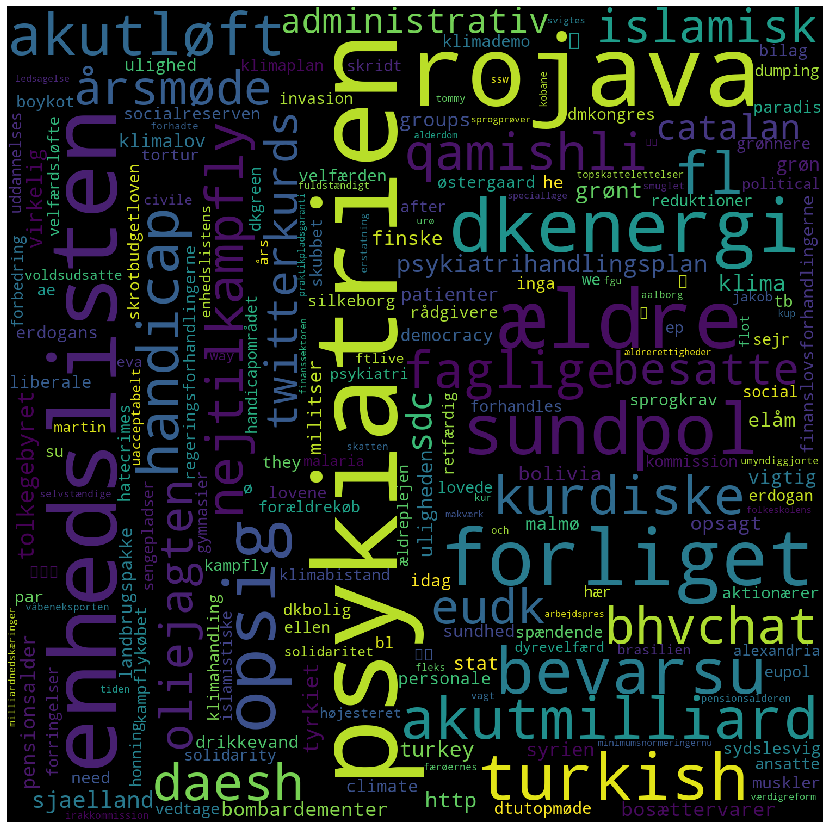

In [139]:
generate_wordcloud(TFIDF_EL)

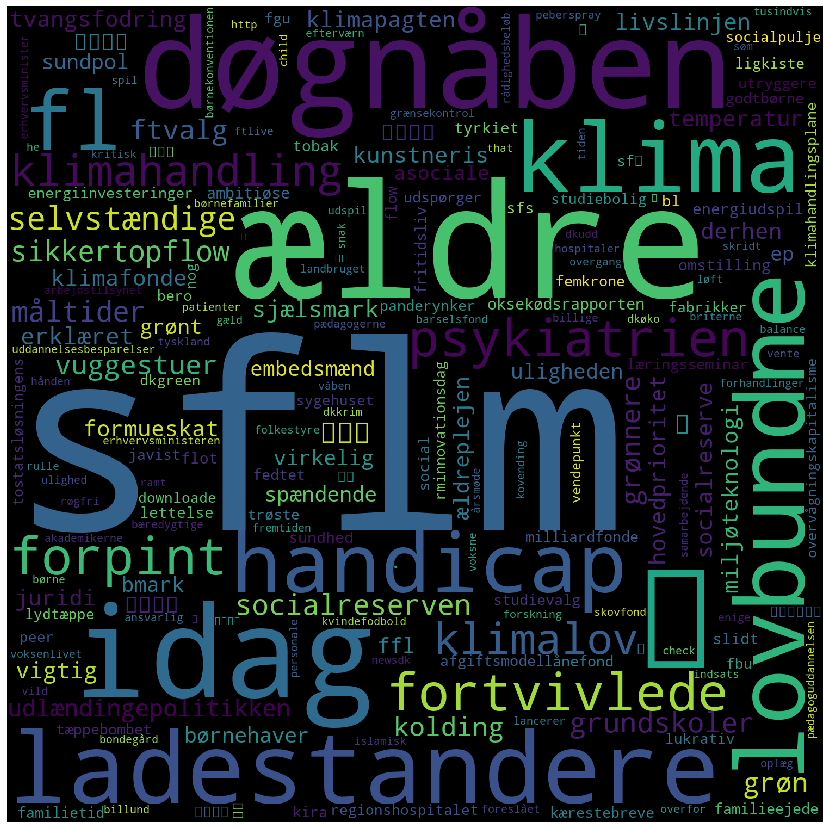

In [140]:
generate_wordcloud(TFIDF_SF)

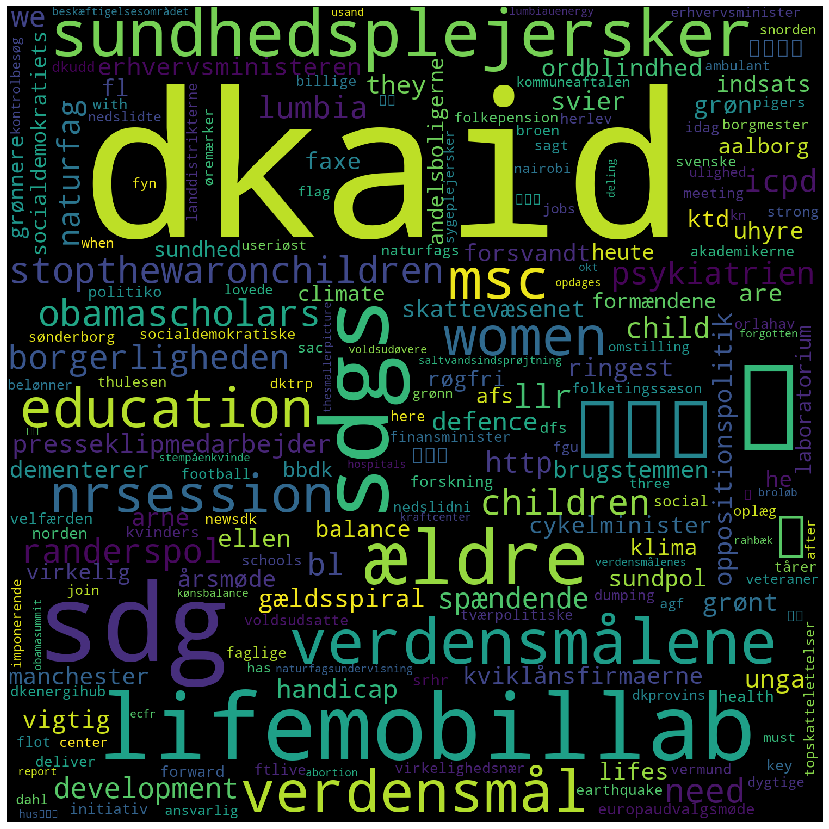

In [141]:
generate_wordcloud(TFIDF_S)

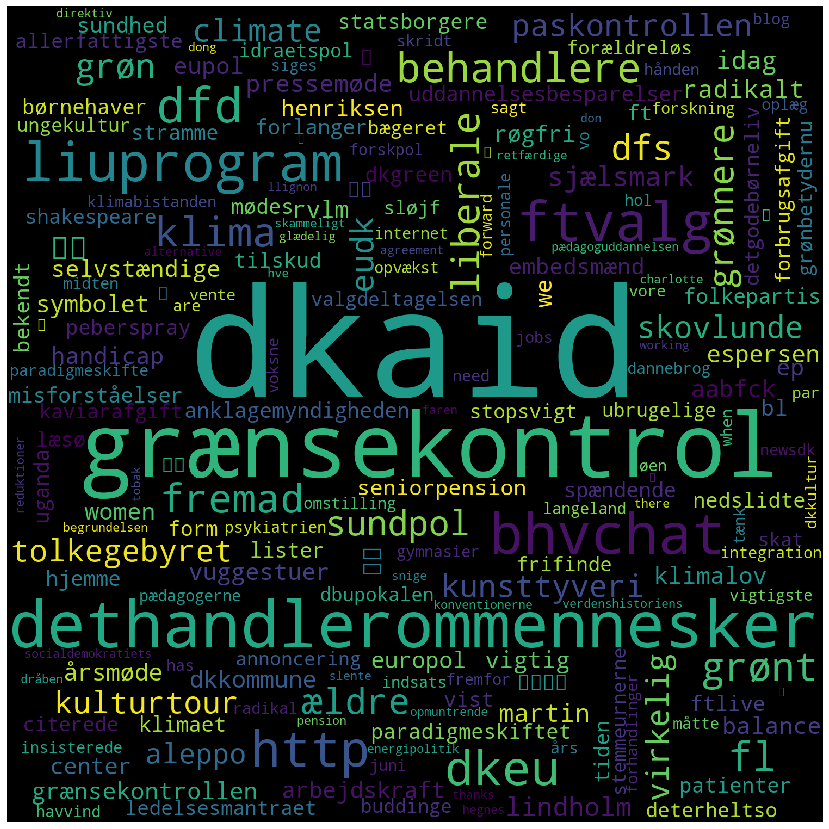

In [142]:
generate_wordcloud(TFIDF_RV)

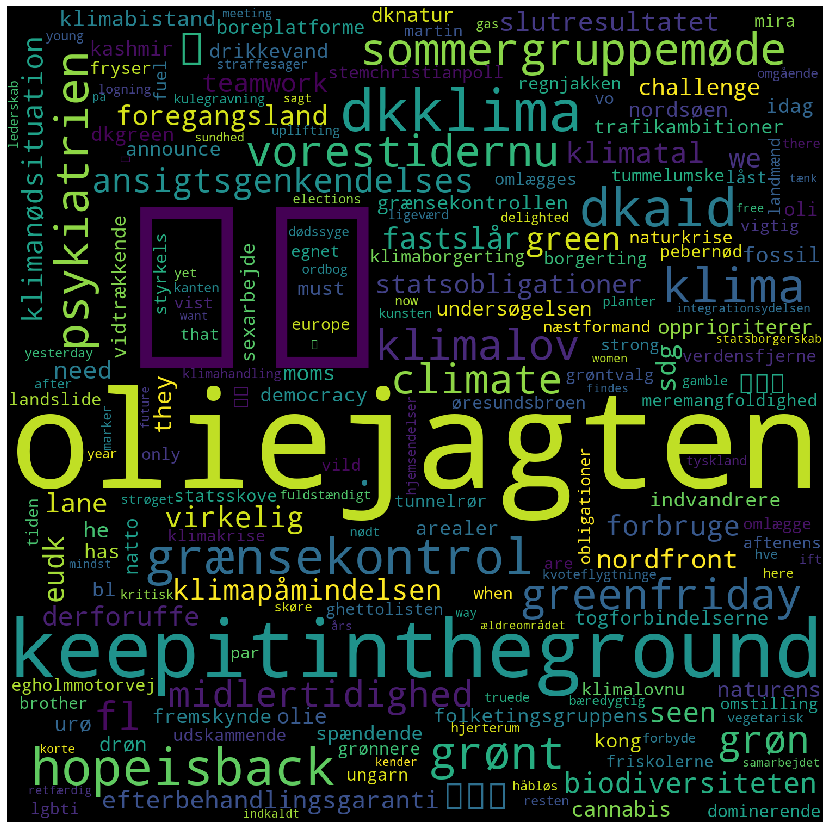

In [143]:
generate_wordcloud(TFIDF_ALT)

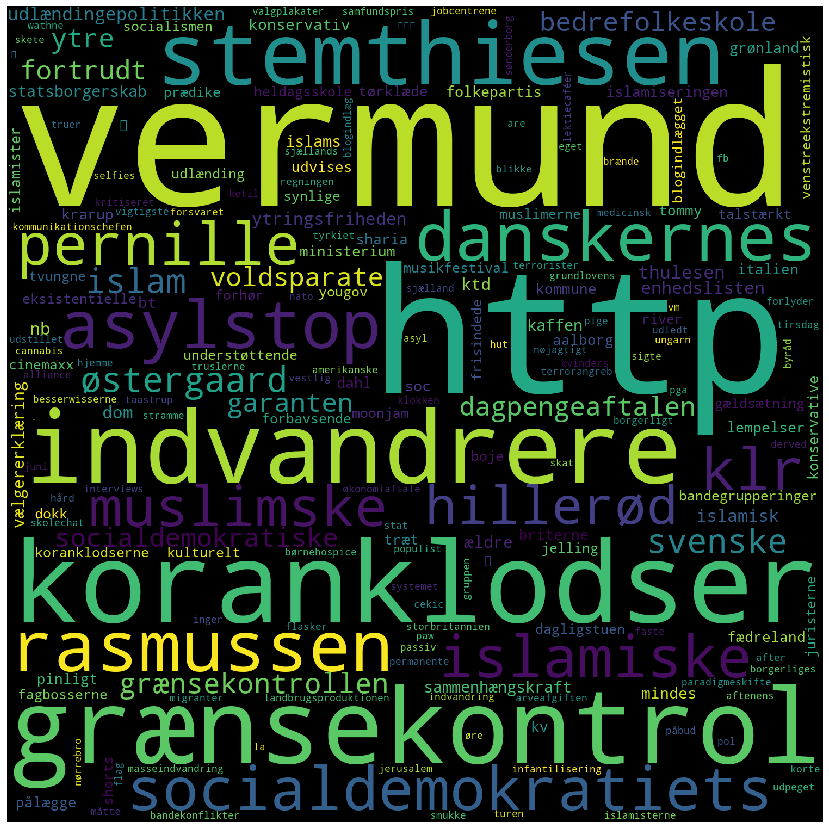

In [144]:
generate_wordcloud(TFIDF_NB)

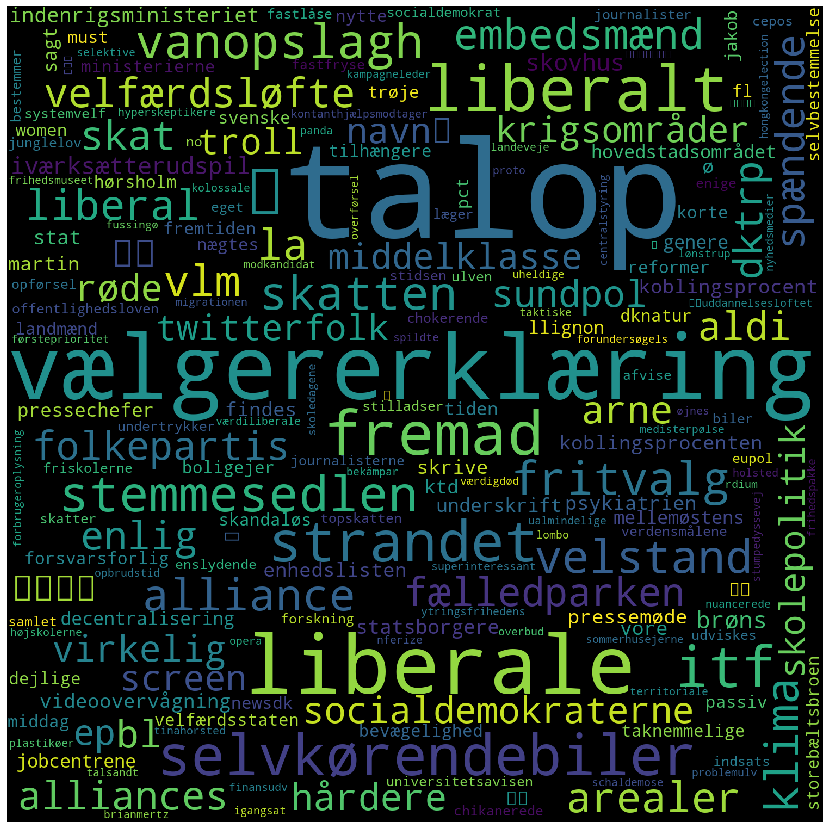

In [145]:
generate_wordcloud(TFIDF_LA)

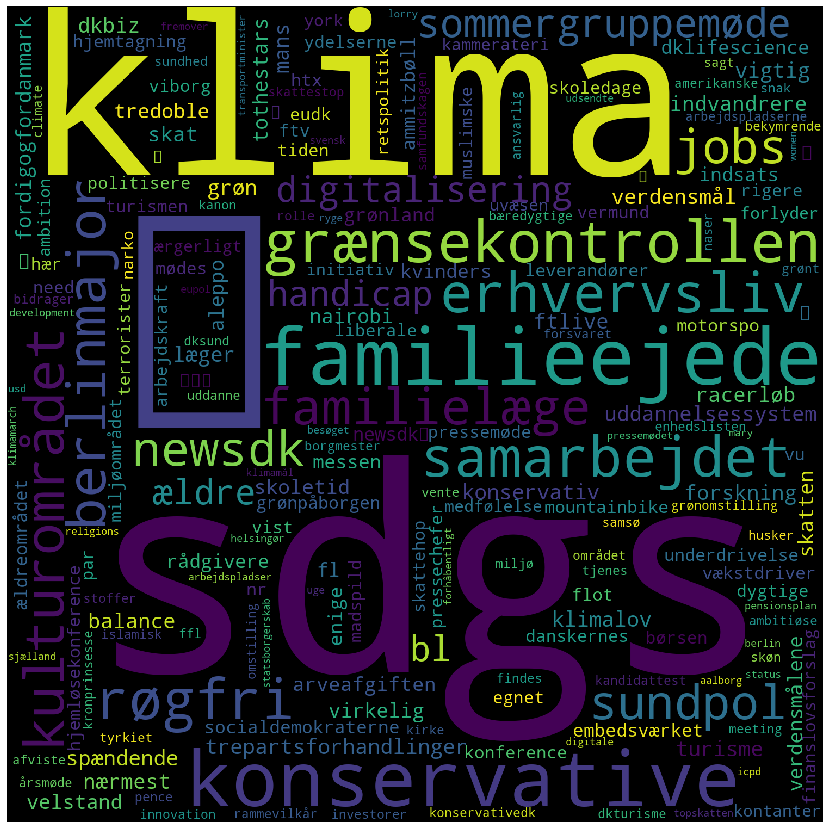

In [146]:
generate_wordcloud(TFIDF_KF)

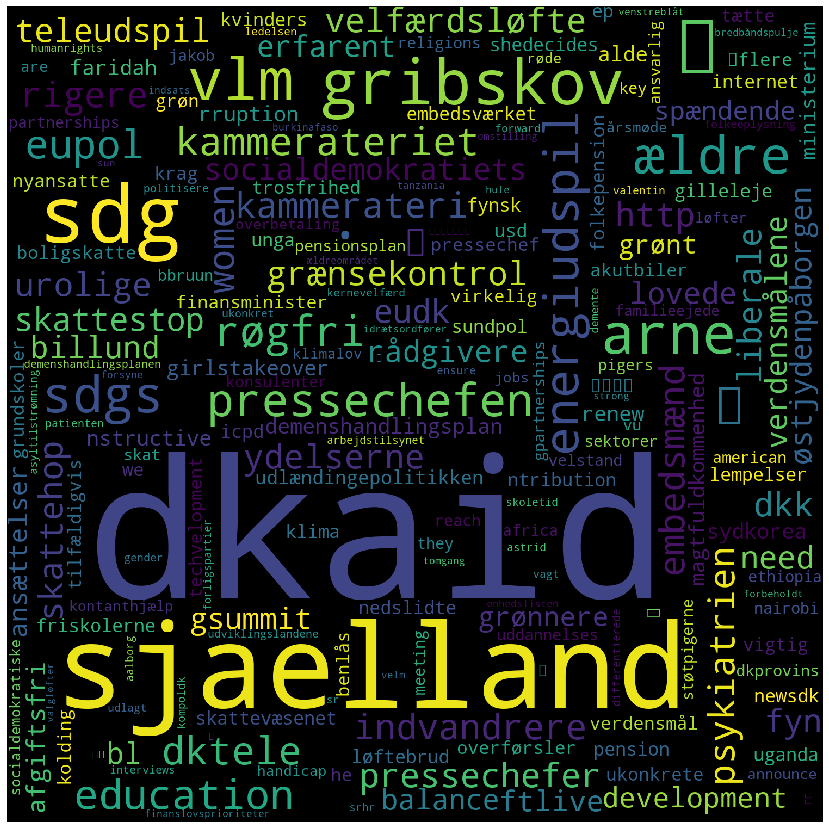

In [147]:
generate_wordcloud(TFIDF_V)

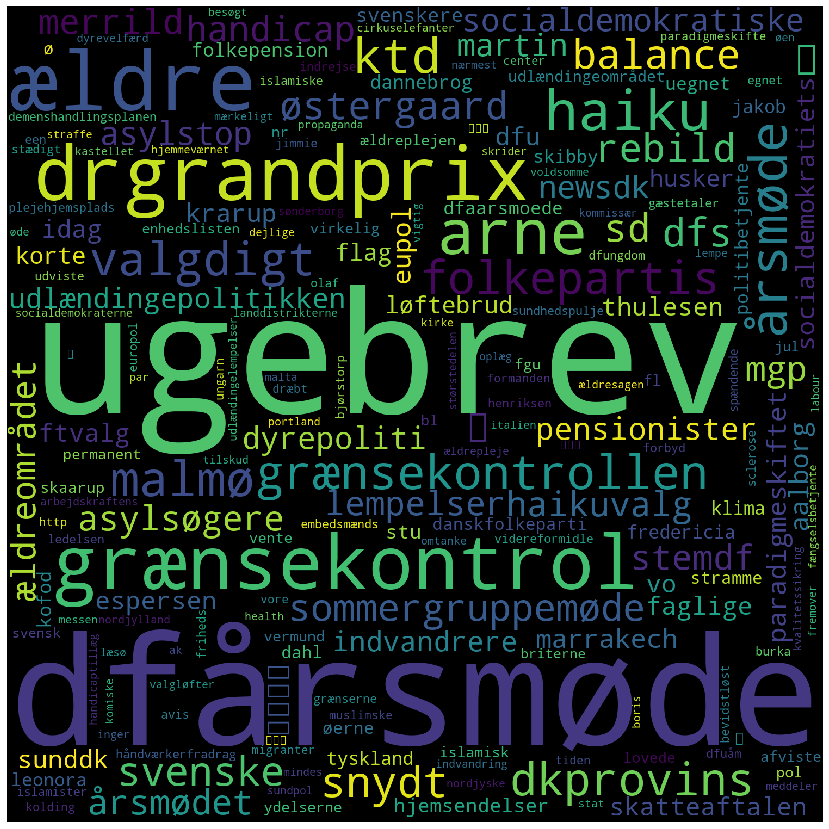

In [148]:
generate_wordcloud(TFIDF_DF)

# TF-IDF Wordclouds

When looking at these wordclouds, many parties can be identified by their wordcloud. That makes the combined TF-IDF results a lot better than when just looking at IDF. 

# Wordcloud without TF-IDF

To more clearly show the power of TF-IDF, wordclouds are now generated based on the most common words from a party only. It becomes very quickly clear that it is a lot more challenging to identify the party based on the word cloud.

In [78]:
EL,SF,S,RV,ALT,NB,LA,KF,V,DF = getWords()

In [149]:
def gen_wordcloud_from_text(tweet_texts):
    tweets_most_common_words = {}
    for word in tweet_texts:
        tweets_most_common_words.setdefault(word,0)
        tweets_most_common_words[word] += 1
        
    wc = WordCloud(width=1500, height=1500)
    wc.generate_from_frequencies(tweets_most_common_words)
    plt.figure(figsize=(15,15))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

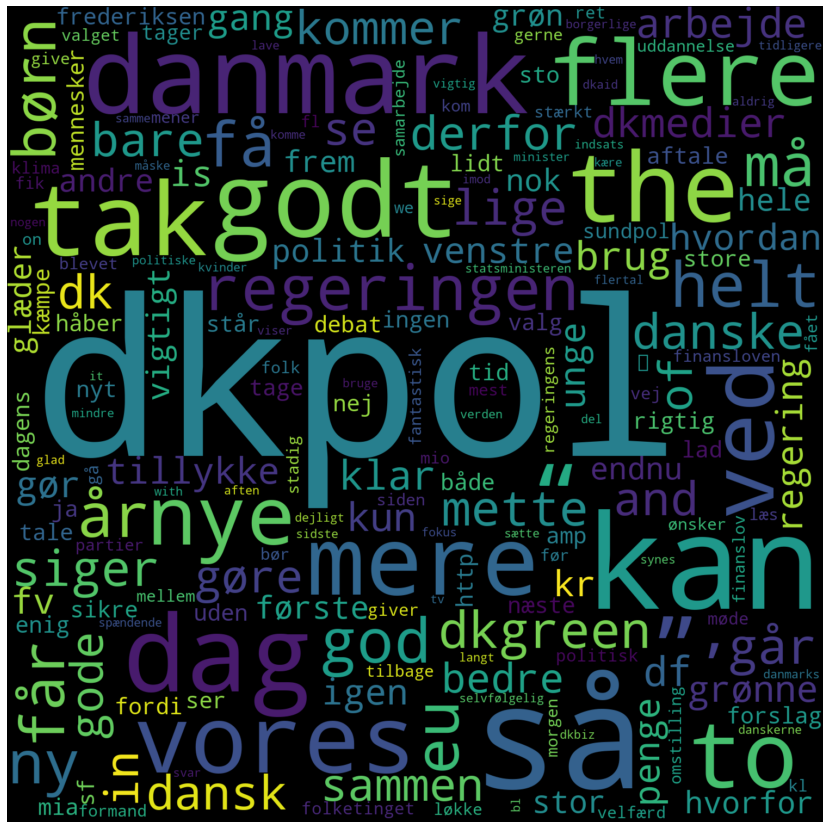

In [150]:
gen_wordcloud_from_text(EL+SF+S+RV+ALT+NB+LA+KF+V+DF)

In [87]:
def make_wordclouds(party_dict):
    for key in party_dict.keys():
        tweets_most_common_words = {}
        for words in party_dict[key]:
            tweets_most_common_words.setdefault(words,0)
            tweets_most_common_words[words] += 1
        wc = WordCloud(width=3600, height=3600)
        wc.generate_from_frequencies(tweets_most_common_words)
        plt.figure(figsize=(20,20))
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        print(key + ":")
        plt.show()

EL:


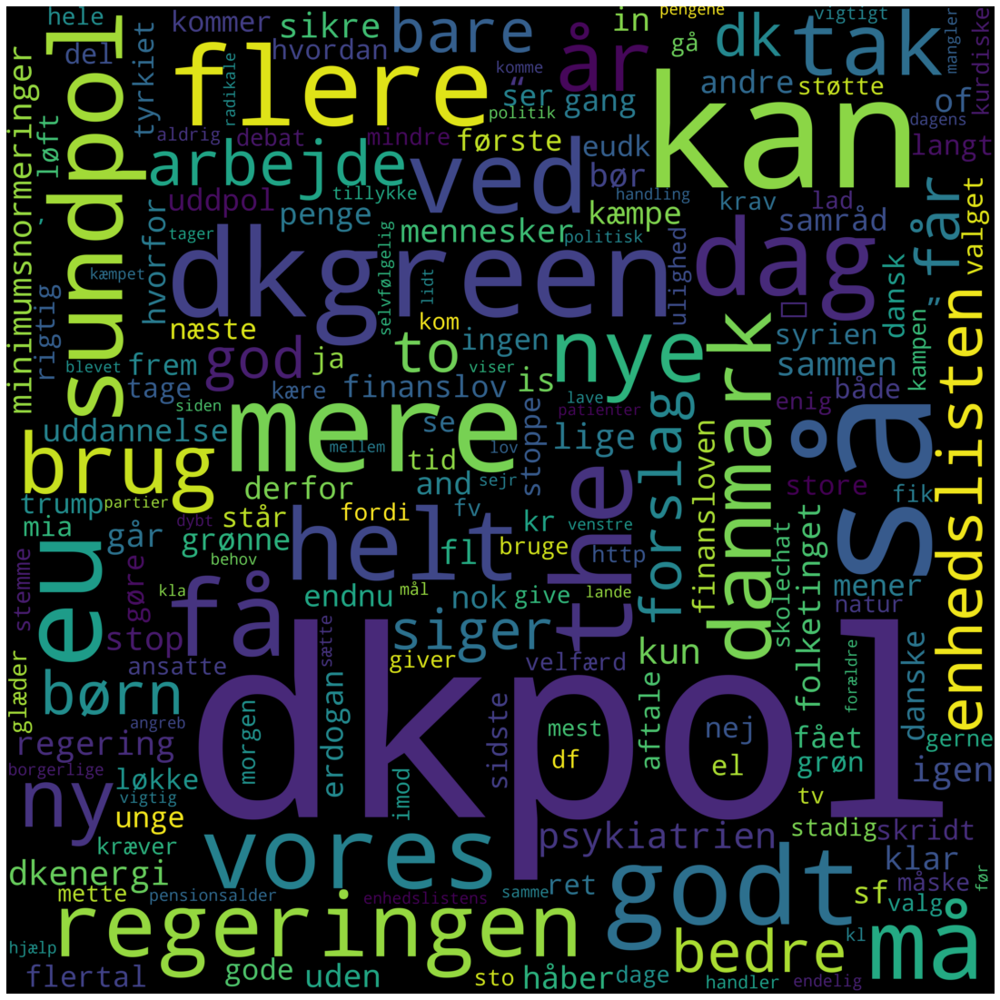

SF:


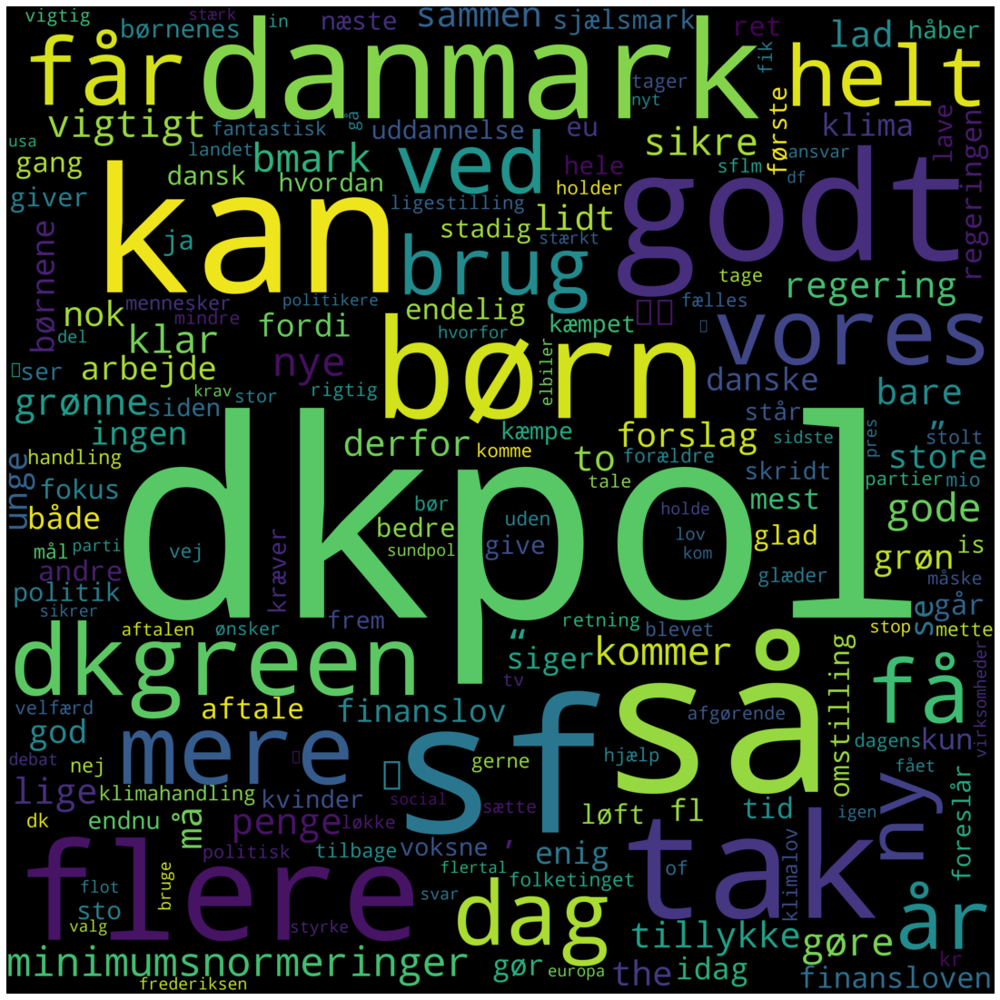

S:


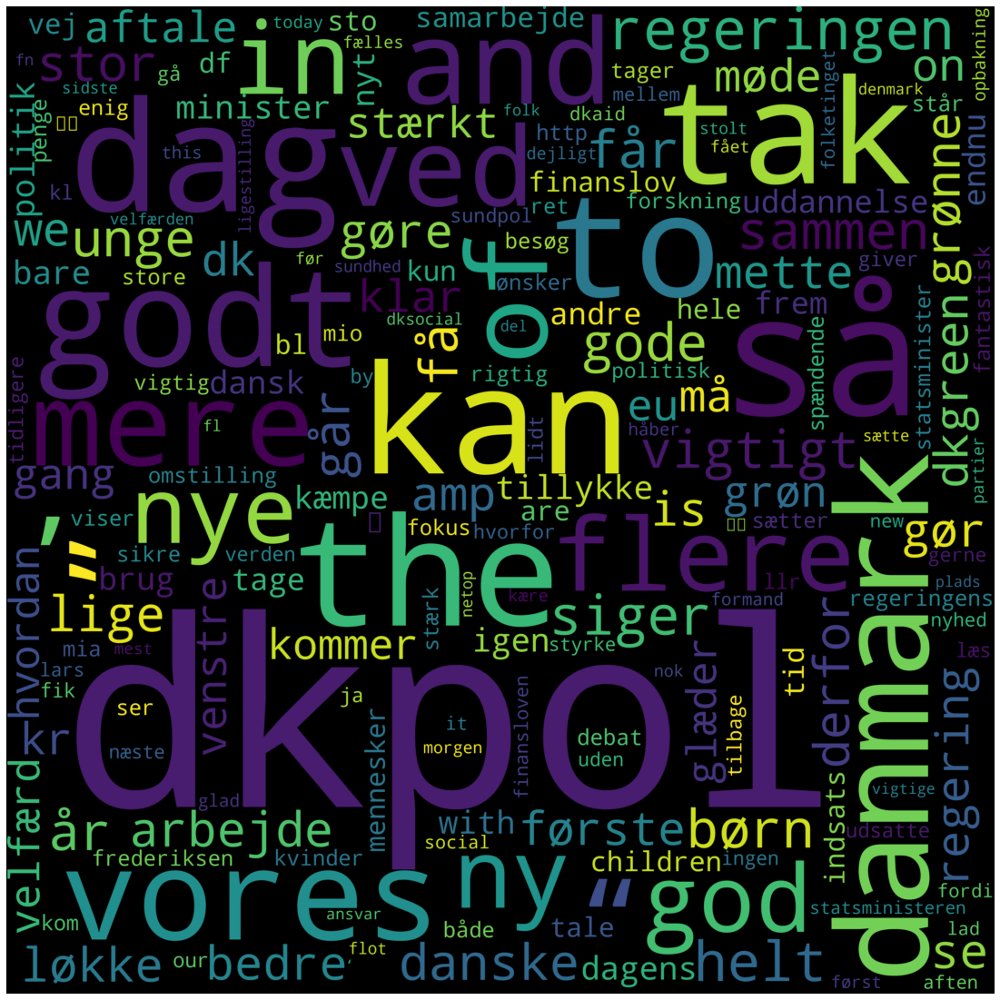

RV:


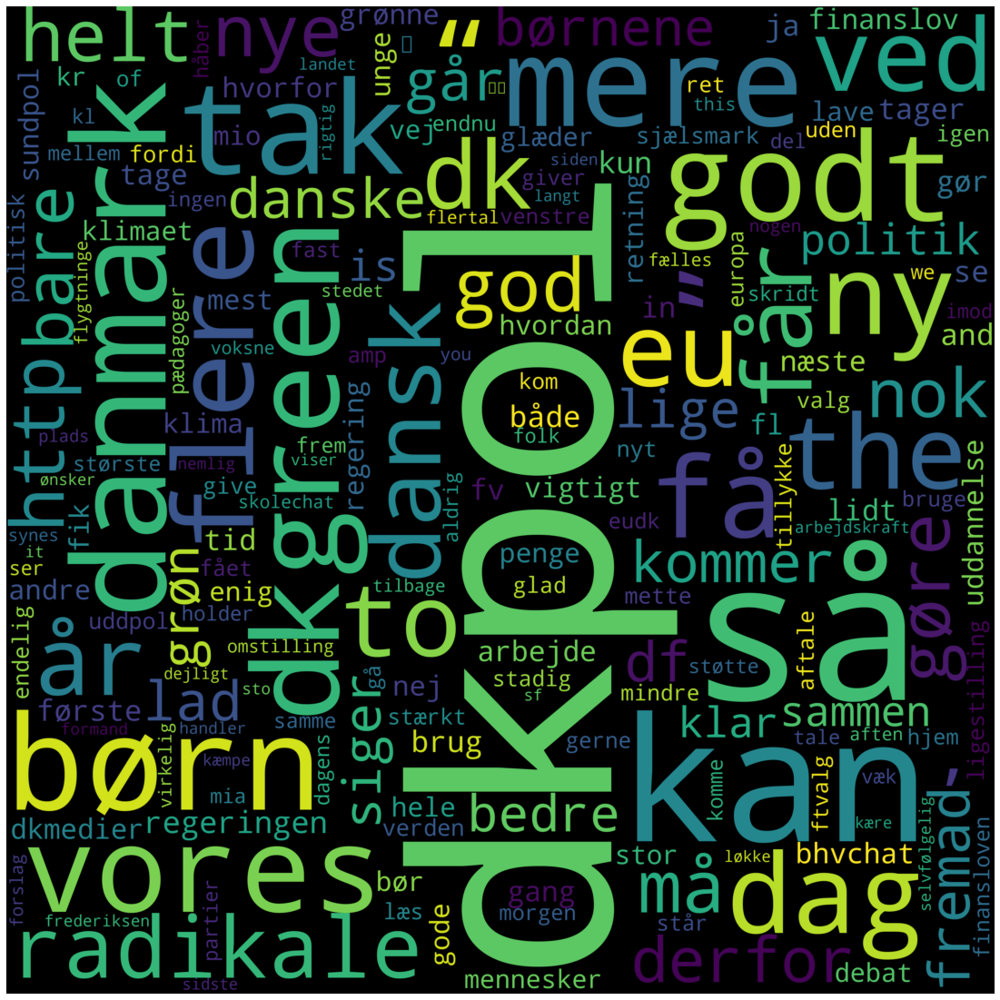

ALT:


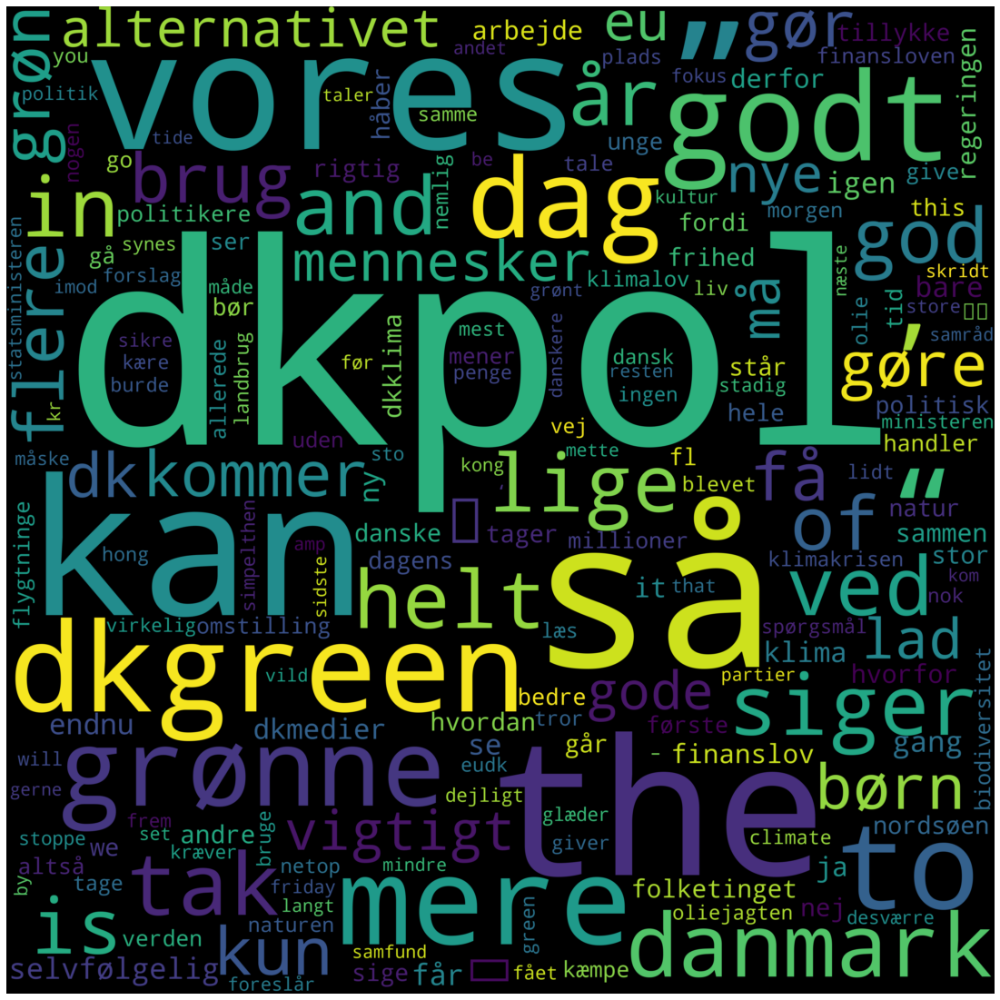

NB:


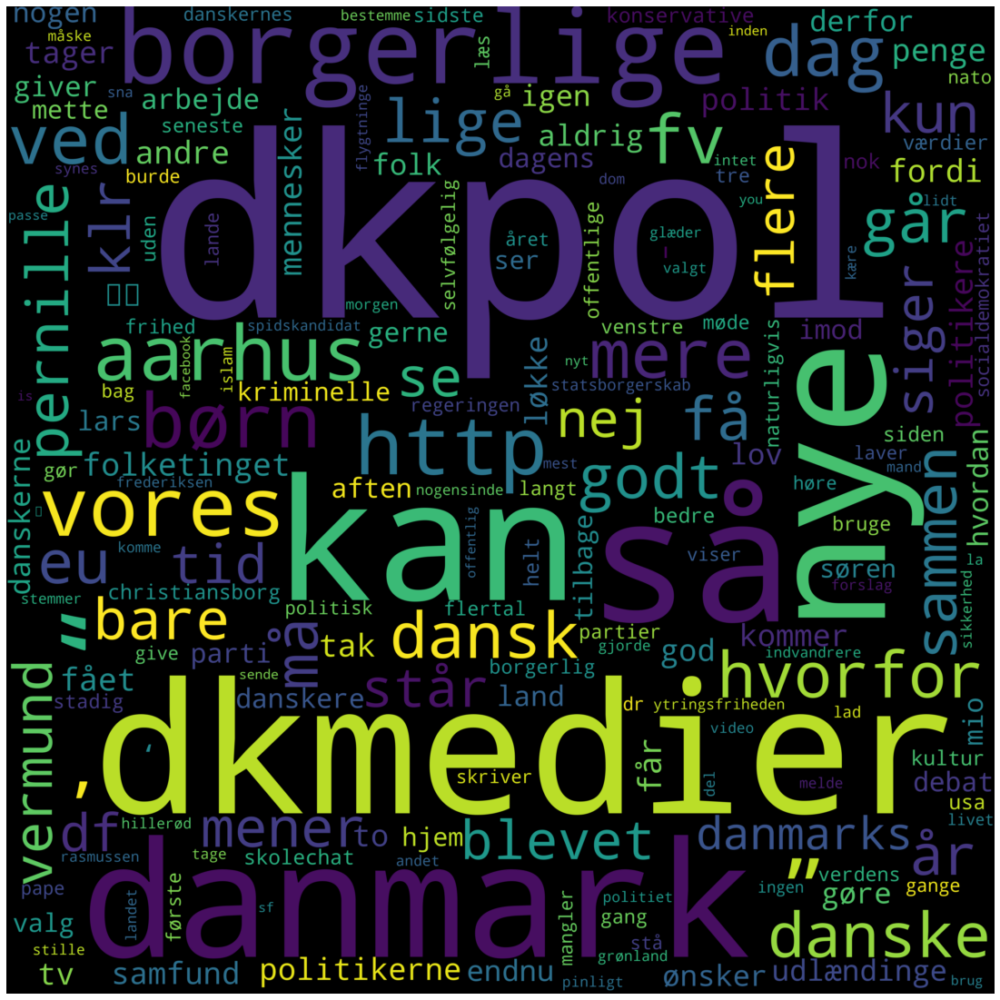

LA:


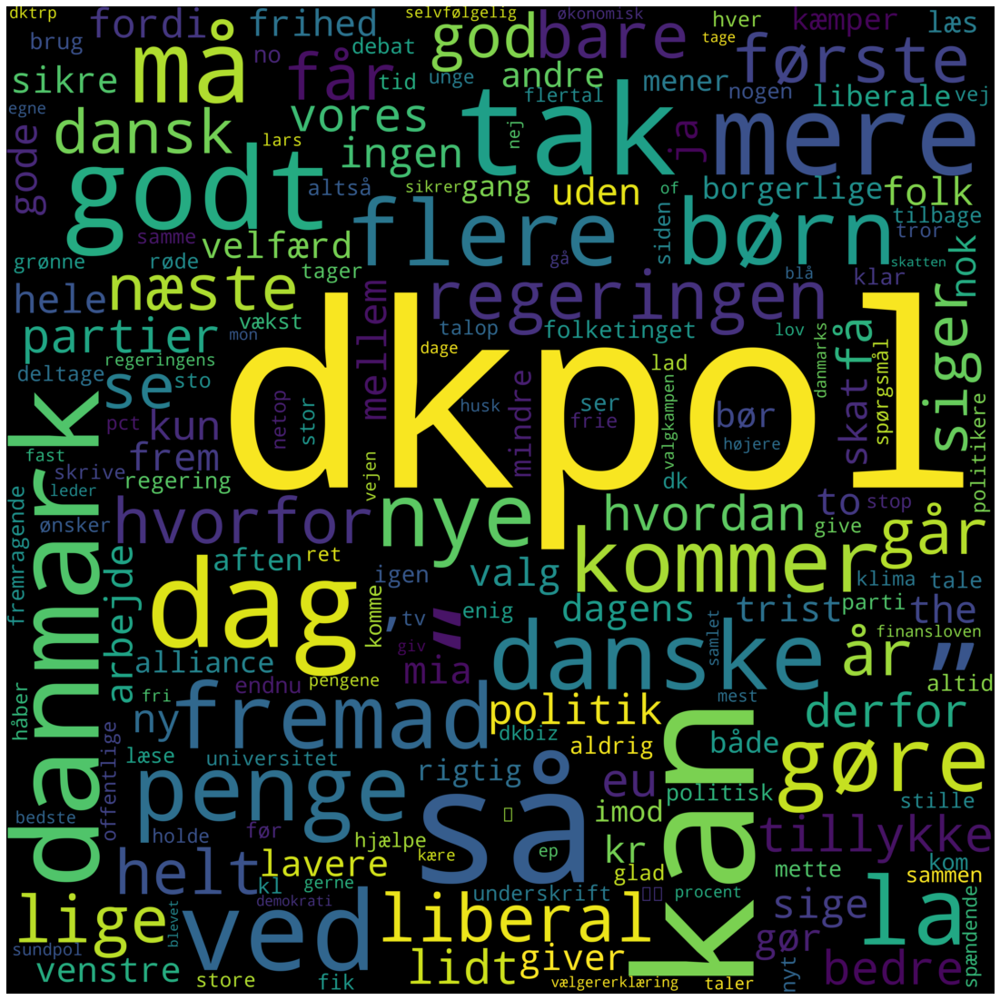

KF:


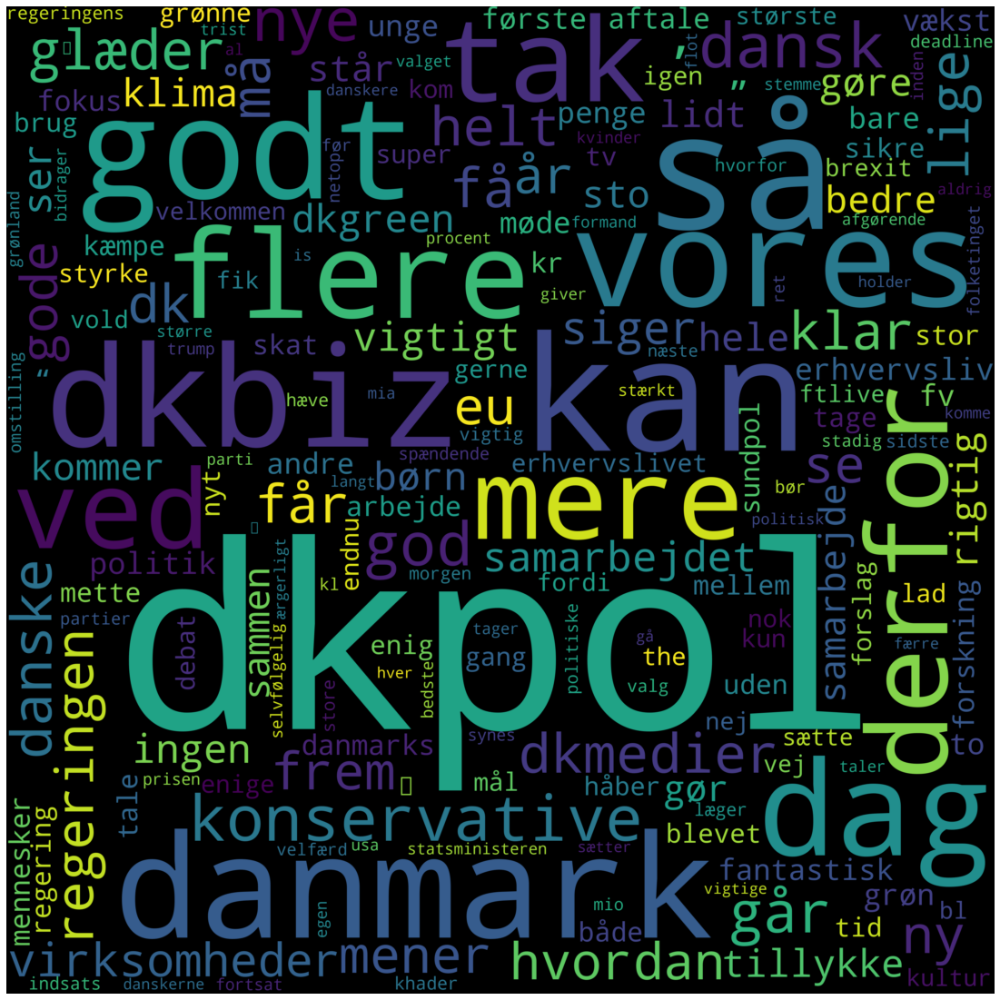

V:


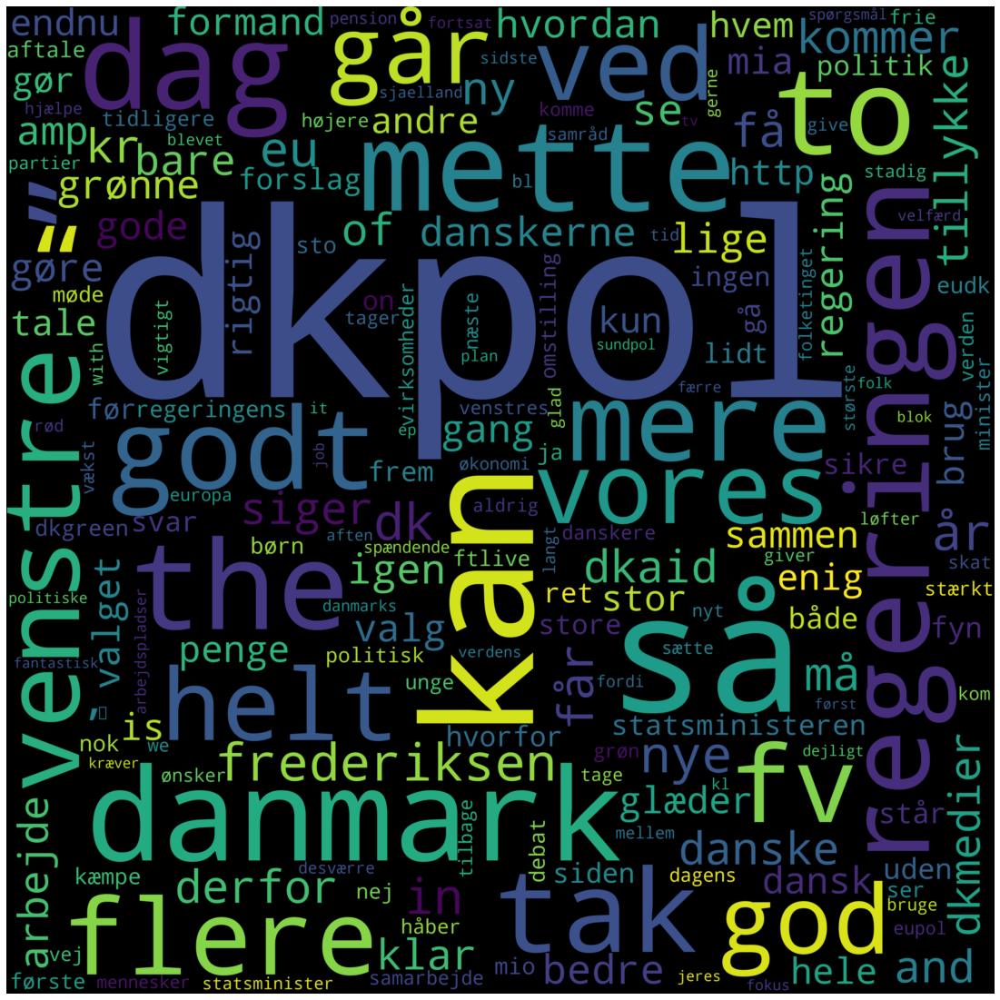

DF:


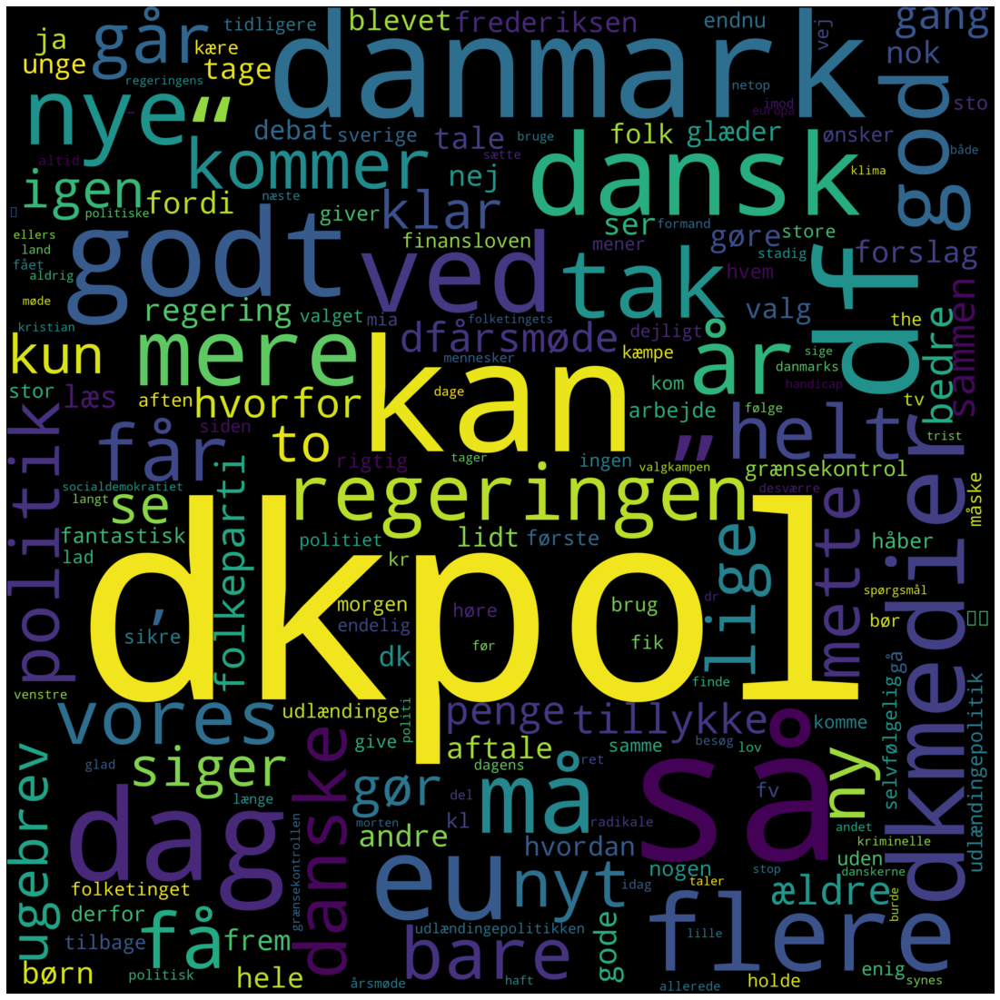

In [135]:
party_words = {"EL":EL,"SF":SF,"S":S,"RV":RV,"ALT":ALT,"NB":NB,"LA":LA,"KF":KF,"V":V,"DF":DF}
make_wordclouds(party_words)

We can identify a few unique words here and there, but most of the unique words refer to their party or the account that represents their party.
Some of the parties also mention "children," and "dkgreen," which is a #dkgreen for tweets about saving Denmark needs to be more green and be a front picture for the world.

# Sentiment Analysis
It is typically said that danish people are happy and in the top 3 happiest countries in the world.
Danish politicians can be seen talking in a serious sense and may not live up to this statement.

Using a data-set that has been generated using a questionnaire and rating system of words from a university, each word has a number that displays how happy a word is. These are, however, in English and need to be converted into danish, which we did by using google translate to translate over 10000+ words.

Hypothesis:
Retweets are generally more positive, while the mention tweets are usually more negative. This is because retweets are indicating that they agree and mentions are when they disagree.


In [75]:
# This code snippet translate the word analysis from english to danish
# DO NOT RUN THIS, it will take several hours
# Use the attached file where the translation has been done allready

def translate_sentiment():
    translator = Translator()
    words = {}
    f = io.open("dataset.txt", "r", encoding = "UTF-8").read()
    fw = open("data/translated_dk.txt","w+")
    fw.write("\n\n\n")
    i = 0
    lst = f.split("\n")[4:]
    total = len(lst)
    for x in lst:
        word = x.split("\t")
        i += 1
        update_progress(i/total, word[0])
        if len(word) == 8:
            try:
                trans = translator.translate(word[0], dest="da", src="en").text
                data = word[0] + "," + trans + "," + word[2] + "\n"
                time.sleep(1)
                fw.write(data)
            except UnicodeEncodeError:
                pass
            
    fw.close()

Now due to the limit of google translate, the generated document can take hours since we don't wish to be banned from using the API. A rough estimated time to generate this file is 8.3 hours, but ensures all words are converted.
Another limitation is some of the words in the data-set are weird or slangs. These can be difficult for the translation and might not even translate it at all, which results in the same word.

There will be words that are not included in the data-set, mostly words like "dkpol" and "dkgreen," which are hashtags used in the tweets.

Now that we have a translated document, we can make our definition/function and use it through each tweet.

In [72]:
words = {}
f = io.open("translated_dk.txt", "r", encoding = "UTF-8").read()
for x in f.split("\n")[4:]:
    word = x.split(",")
    if len(word) == 3:
        words.setdefault(word[1],word[2])

def calc_sentiment(tokens):
    total = 0.0
    length = 0
    errors = 0
    for x in tokens:
        try:
            rate = float(words[x].replace(",","."))
            if rate < 9:
                total += rate
                length += +1
        except (KeyError,ValueError):
            errors += 1
    average = total/length
    return average

Below are a few tests to make sure the rating works

In [73]:
calc_sentiment(["glad","kærlighed","glæde"])

7.48

In [74]:
calc_sentiment(["noget","ses","okay"])

5.486666666666667

Now that the tests prove it works, we can run through the tweets for each party and check their average and standard deviation, which will be used later on for a threshold to gather negative and positive tweets and make a word cloud out of these results.

In [97]:
party_words = {"EL":EL,"SF":SF,"S":S,"RV":RV,"ALT":ALT,"NB":NB,"LA":LA,"KF":KF,"V":V,"DF":DF}

for party in party_words.keys():
    total = 0
    total = calc_sentiment(party_words[party])
    print("The average m for " + party + " = " + str(total))  

The average m for EL = 5.888674841772283
The average m for SF = 5.990718479604511
The average m for S = 5.966826793790426
The average m for RV = 5.921596221387982
The average m for ALT = 5.9293247482252145
The average m for NB = 5.854328118732436
The average m for LA = 5.946609262276014
The average m for KF = 5.999789191902331
The average m for V = 5.927037037037018
The average m for DF = 5.9095987336763525


In [102]:
def calc_sentiment_sd(tokens):
    list_sen = []
    for x in tokens:
        try:
            rate = float(words[x].replace(",","."))
            if rate < 9:
                list_sen.append(rate)
        except (KeyError,ValueError):
            pass
    return statistics.stdev(list_sen)

for party in party_words.keys():
    sd_dem = calc_sentiment_sd(party_words[party])
    print("The standard deviation for " + party + " = " + str(sd_dem))  
  


The standard deviation for EL = 0.8166323548663215
The standard deviation for SF = 0.8354305144664024
The standard deviation for S = 0.8145996092914374
The standard deviation for RV = 0.7962517692685146
The standard deviation for ALT = 0.812305859157155
The standard deviation for NB = 0.7709113136091549
The standard deviation for LA = 0.8263488911950976
The standard deviation for KF = 0.8112235348890368
The standard deviation for V = 0.8185505944480842
The standard deviation for DF = 0.8299994309472645


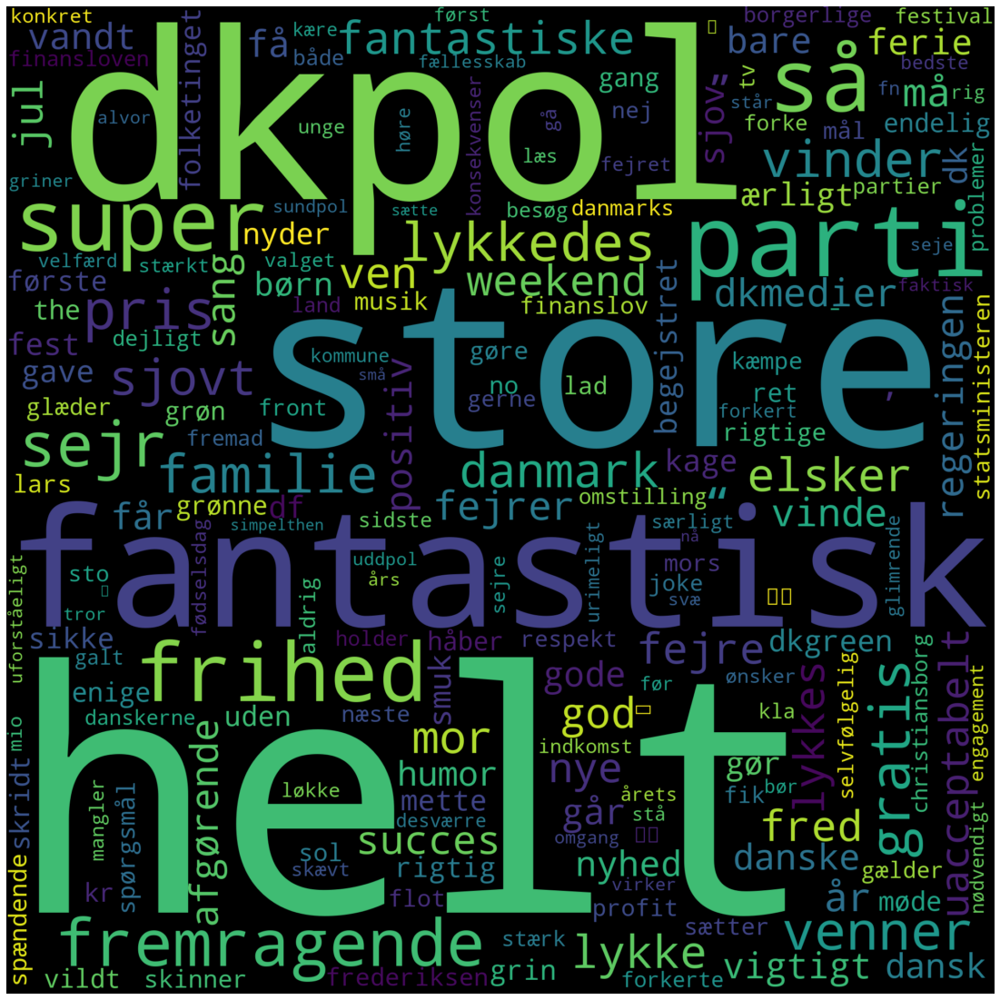

In [136]:
# Positive Tweets
neg_tweets_dem = []

sen_sd = calc_sentiment_sd(EL+SF+S+RV+ALT+NB+LA+KF+V+DF)
sen = calc_sentiment(EL+SF+S+RV+ALT+NB+LA+KF+V+DF)
threshold = sen+2*sen_sd 

for party in party_words.keys():
    for word in party_words[party]:
        try:
            sen = calc_sentiment([word])
        except ZeroDivisionError:
            pass
        if (sen > threshold):
            neg_tweets_dem.append(word)

tweets_dem_words = {}
for x in neg_tweets_dem:
    for y in x.split(" "):
        tweets_dem_words.setdefault(y,0)
        tweets_dem_words[y] += 1
wc = WordCloud(width=2000, height=2000)
wc.generate_from_frequencies(tweets_dem_words)
plt.figure(figsize=(20,20))
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

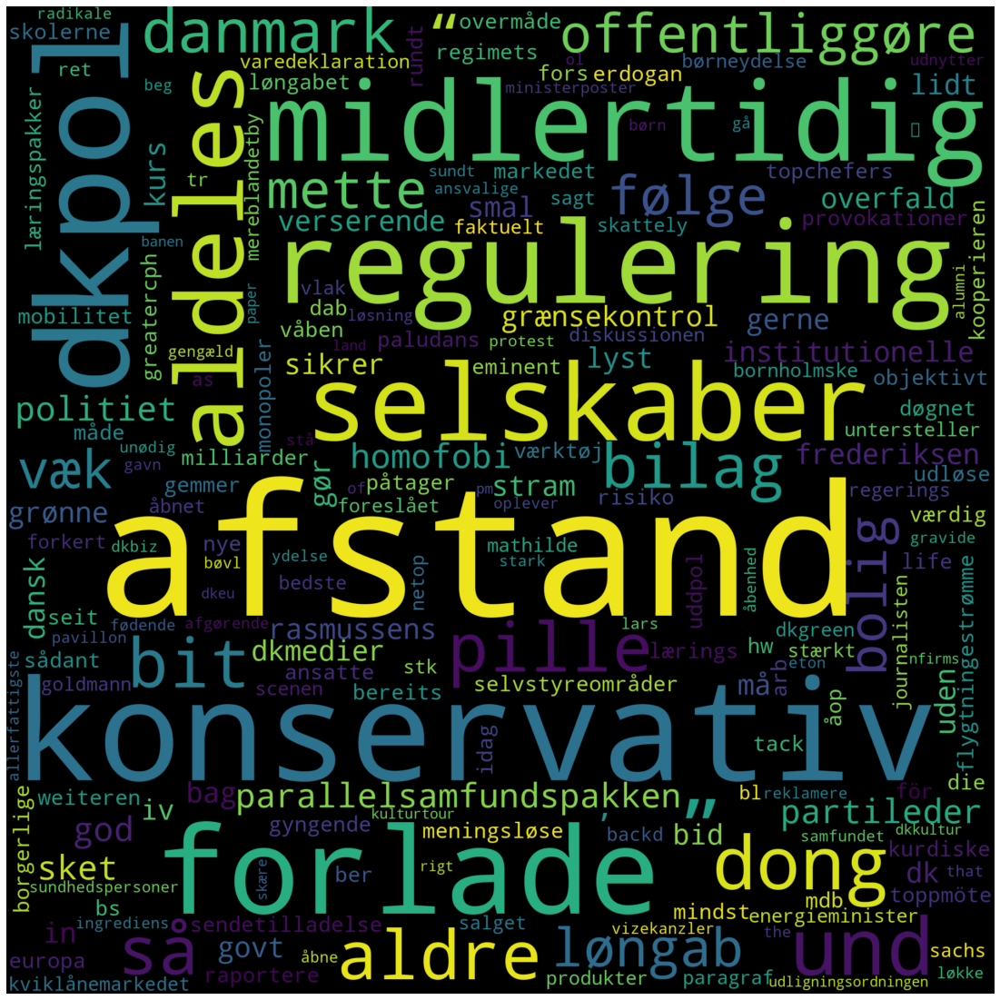

In [137]:
# Negative Tweets
neg_tweets_dem = []

sen_sd = calc_sentiment_sd(EL+SF+S+RV+ALT+NB+LA+KF+V+DF)
sen = calc_sentiment(EL+SF+S+RV+ALT+NB+LA+KF+V+DF)
threshold = sen-1.7*sen_sd 

for party in party_words.keys():
    for word in party_words[party]:
        try:
            sen = calc_sentiment([word])
        except ZeroDivisionError:
            pass
        if (sen < threshold):
            neg_tweets_dem.append(word)

tweets_dem_words = {}
for x in neg_tweets_dem:
    for y in x.split(" "):
        tweets_dem_words.setdefault(y,0)
        tweets_dem_words[y] += 1
wc = WordCloud(width=2000, height=2000)
wc.generate_from_frequencies(tweets_dem_words)
plt.figure(figsize=(20,20))
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

The positive wordcloud have mostly positive words and can be said to be well done. The negative however, is not so good. It has some negative words, but most of the words in the cloud are not negativ





# Discussion

Working with the danish politics has been a interesting experience since they are more localized than the U.S. politics data we had practiced on. Because of the chosen data is similiar in what we have practiced, it was easy to know how to handle the data.

## Challenges
One of the problematic parts was that Denmark has several more parties than the U.S. This makes analyzing the data more difficult.
Another challenge was the language. Since the danish politicians mostly tweets in danish, we had to do some translation. Sentiment analysis was one of the things that needed a translation. We either had to translate the sentiment analysis file or tweets.  Slang was also making the interpretation problematic since it is not always possible to do a direct translation. 


## Improvements
The data and analytics can be expanded by using a lot more parameters to gather more data and members.
- Mentions (These can be further investigated deeper with more parameters, theories or libraries. Example; topics they debate about)
- Age (The politicians could have related or different oppinion)
- Periods (There were different people in the danish parliament at each election)
- Politics outside or parliaments (Those who did not make it into the parliament)
- Party twitter accounts
These will just extend and compare further data.

## Wikipages
We have tried using the Wiki pages from each of the politics. However, their wiki pages were insufficient, so we excluded this.

## Mentions
For the Twitter mentions, it has been clearly shown that they are arguing in responses to twitter debates. They also congratulate or mention someone who did something great, as well as an acknowledgment. This indicates that mentions in the danish parliament mean a lot more than just retweeting, agreeing on their tweets.

However, their agreement to different parties cannot be identified in the mentions since they are debating, which can either be agreeing or disagreeing on the various topics.

## Wordcloud
In terms of the wordclouds, it is clear the IDF wordclouds has a lot more uniqueness for each party than the wordclouds that takes the most common words. But we still wish to show both parts since they still show some significant words being used in general.

# Contribution

Stephan focused on retweets.
Mathias focused on mentions.
Jonas focused on word-clouds 